In [2]:
import numpy as np
import pandas as pd
import random
import copy
import matplotlib.pyplot as plt
from pymoo.core.problem import Problem
from pymoo.problems import get_problem
from pymoo.util.plotting import plot
from pymoo.util.ref_dirs import get_reference_directions
from pymoo.visualization.scatter import Scatter

from pymoo.algorithms.moo.nsga2 import NSGA2
from pymoo.optimize import minimize

from pymoo.indicators.igd import IGD
from pymoo.indicators.gd import GD
from pymoo.indicators.hv import HV

## Hito 1 para problemas multi-objetivo

In [10]:
def select(pop, T, fit):
    """
    Selección por torneo basada en el frente de Pareto.
    Selecciona al mejor individuo del torneo con T competidores.
    
    Args:
        pop (list): Población de individuos.
        T (int): Tamaño del torneo.
        fit (func): Función de evaluación de individuos.
        
    Returns:
        Individuo seleccionado (copia).
    """
    # Seleccionar T individuos al azar de la población
    tournament = random.sample(pop, T)
    
    # Determinar el mejor individuo (menor suma de objetivos o primera métrica)
    # Aquí usamos la suma de valores objetivos como criterio de selección.
    best_individual = min(tournament, key=lambda ind: sum(fit(ind)))
    
    return copy.deepcopy(best_individual)


def crossover(ind1, ind2, pcross, alpha=0.5):
    """
    Crossover BLX-alpha para vectores continuos.

    Args:
        ind1, ind2: Padres (vectores).
        pcross: Probabilidad de cruce.
        alpha: Factor de mezcla. Por defecto 0.5 (punto medio).

    Returns:
        Hijos generados.
    """
    if random.random() < pcross:
        child1 = [(1 - alpha) * x1 + alpha * x2 for x1, x2 in zip(ind1, ind2)]
        child2 = [alpha * x1 + (1 - alpha) * x2 for x1, x2 in zip(ind1, ind2)]
        return child1, child2
    else:
        return ind1, ind2


def mutate(individual, pmut=0.1, delta_max=1):
    """
    Función de mutación simple para el problema ZDT1.
    
    :param individual: Lista de variables de un individuo.
    :param pmut: Probabilidad de mutación para cada variable (0.0 a 1.0).
    :param delta_max: El máximo cambio permitido en cada variable.
    :return: Nuevo individuo mutado.
    """
    for i in range(len(individual)):
        if random.random() < pmut:  # Aplicar mutación con probabilidad pmut
            delta = random.uniform(-delta_max, delta_max)  # Cambio aleatorio dentro del intervalo [-delta_max, delta_max]
            individual[i] = individual[i] + delta
            # Asegurar que los valores estén dentro del intervalo [0, 1]
            individual[i] = max(0, min(1, individual[i]))

    return individual

---
## ZDT1

Ejecutando NSGA-II...
n_gen  |  n_eval  | n_nds  |      igd      |       gd      |       hv     
     1 |      100 |     14 |  2.1848730742 |  2.8929898864 |  0.000000E+00
     2 |      200 |     16 |  2.1656090356 |  2.9316765172 |  0.000000E+00
     3 |      300 |     15 |  1.9821649741 |  2.8677766579 |  0.000000E+00
     4 |      400 |     14 |  1.9821649741 |  2.6057310155 |  0.000000E+00
     5 |      500 |     15 |  1.9076759787 |  2.8429659876 |  0.000000E+00
     6 |      600 |     16 |  1.8203458814 |  2.3827913150 |  0.000000E+00
     7 |      700 |     17 |  1.7320114984 |  1.9387979818 |  0.000000E+00
     8 |      800 |      9 |  1.4928643491 |  1.8358723048 |  0.000000E+00
     9 |      900 |     10 |  1.2411667390 |  1.6502547652 |  0.000000E+00
    10 |     1000 |     14 |  1.2411667390 |  1.5535887645 |  0.000000E+00
    11 |     1100 |     14 |  1.2382957497 |  1.5769600975 |  0.000000E+00
    12 |     1200 |     18 |  1.1553592924 |  1.3803068181 |  0.000000E+00
   

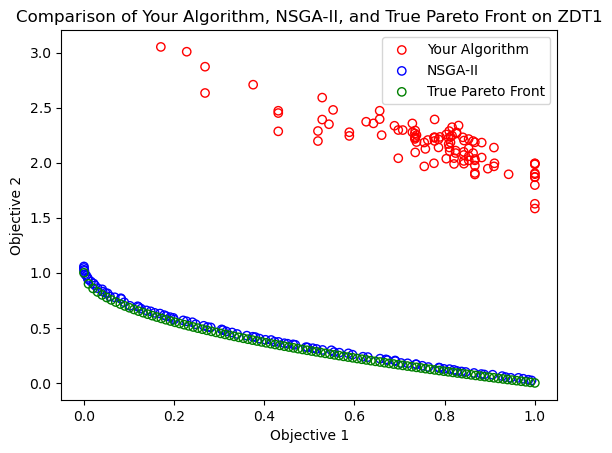

In [11]:
# Definir el problema ZDT1 usando pymoo
problem = get_problem("zdt1")

# Función de fitness para tu algoritmo (ZDT1)
def evaluate_objectives(individual):
    """
    Define the multi-objective problem.
    Replace this with your actual problem's objective functions.
    Example: ZDT1 test function.
    """
    f1 = individual[0]
    g = 1 + 9 * np.sum(individual[1:]) / (len(individual) - 1)
    f2 = g * (1 - np.sqrt(f1 / g))
    return [f1, f2]

# Crear población para tu algoritmo, asegurando que esté en el espacio [0, 1]
def create(alphabet, N=100):
    pop = []
    for _ in range(N):
        ind = copy.deepcopy(alphabet)
        random.shuffle(ind)
        pop.append([min(max(x, 0), 1) for x in ind])  # Asegurarse de que los valores estén en [0, 1]
    return pop

# Función de ordenación de población por fitness
def sort_pop(pop, fit):
    fitness = [fit(ind) for ind in pop]
    pareto_front = pareto_rank(fitness)
    sorted_pop = [pop[i] for i in pareto_front]
    sorted_fitness = [fitness[i] for i in pareto_front]
    return sorted_pop, sorted_fitness

def pareto_rank(fitness):
    ranked = []
    for i in range(len(fitness)):
        rank = 0
        for j in range(len(fitness)):
            if i != j and dominates(fitness[j], fitness[i]):
                rank += 1
        ranked.append((i, rank))
    ranked.sort(key=lambda x: x[1])
    return [i[0] for i in ranked]

def dominates(f1, f2):
    return all(f1[i] <= f2[i] for i in range(len(f1))) and any(f1[i] < f2[i] for i in range(len(f1)))

# Función de evolución del algoritmo
def evolve(pop, fit, pmut, ngen=100, T=2, elitism=False, verbose=False):
    pop, _ = sort_pop(pop, fit)
    best = pop[0]
    
    # Inicialización de métricas
    igd_metric = IGD(problem.pareto_front())
    gd_metric = GD(problem.pareto_front())
    hv_metric = HV(ref_point=np.array([1.0, 1.0]))  # El punto de referencia para HV debe ser (1.0, 1.0) para ZDT1

    for gen in range(ngen):
        newpop = []
        if elitism:
            newpop.append(best)
        while len(newpop) < len(pop):
            ind1 = select(pop, T, evaluate_objectives)
            ind2 = select(pop, T, evaluate_objectives)
            child1, child2 = crossover(ind1, ind2, pcross=0.7)
            child1 = mutate(child1, pmut)
            child2 = mutate(child2, pmut)
            newpop.append(child1)
            newpop.append(child2)
        pop = newpop
        pop, _ = sort_pop(pop, fit)
        best = pop[0]

        # Calcular métricas
        pop_fitness = np.array([fit(ind) for ind in pop])  # Asegurarse de que sea un np.array 2D
        igd_value = igd_metric(pop_fitness)
        gd_value = gd_metric(pop_fitness)
        hv_value = hv_metric(pop_fitness)

        # Mostrar métricas cada generación
        if verbose:
            print(f"{gen+1:6} | {len(pop) * (gen+1):8} | {len(pop)} | {igd_value:.10f} | {gd_value:.10f} | {hv_value:.10e}")

    return pop

# Función para ejecutar tu algoritmo
def run_your_algorithm(ngen, verbose=False):
    alphabet = [i / 100.0 for i in range(100)]  # Definir el alfabeto en el espacio [0, 1]
    N = 100  # Población de 100 individuos
    pop = create(alphabet, N)
    pmut = 0.1
    best = evolve(pop, evaluate_objectives, pmut, ngen=ngen, T=2, elitism=True, verbose=verbose)
    return np.array([evaluate_objectives(ind) for ind in best])

# Ejecutar NSGA-II usando pymoo
algorithm = NSGA2(pop_size=100)
print("Ejecutando NSGA-II...")
res = minimize(problem, algorithm, termination=('n_gen', 100), verbose=True)

# Ejecutar tu algoritmo con métricas
print("Ejecutando tu algoritmo...")
your_algo_front = run_your_algorithm(ngen=1000, verbose=True)

# Visualizar los frentes de Pareto de ambos algoritmos y el frente verdadero
plt.scatter(your_algo_front[:, 0], your_algo_front[:, 1], label="Your Algorithm", color='r', marker='o', edgecolor='r', facecolor='none')
plt.scatter(res.F[:, 0], res.F[:, 1], label="NSGA-II", color='b', marker='o', edgecolor='b', facecolor='none')
plt.scatter(problem.pareto_front()[:, 0], problem.pareto_front()[:, 1], label="True Pareto Front", color='g', marker='o', edgecolor='g', facecolor='none')
plt.xlabel("Objective 1")
plt.ylabel("Objective 2")
plt.legend()
plt.title("Comparison of Your Algorithm, NSGA-II, and True Pareto Front on ZDT1")
plt.show()

Run 1/10
Run 2/10
Run 3/10
Run 4/10
Run 5/10
Run 6/10
Run 7/10
Run 8/10
Run 9/10
Run 10/10
           Estadístico        GD       IGD        HV
0               Mínimo  0.004680  0.007790  0.000000
1               Máximo  2.588288  2.815801  0.653940
2                Media  0.261427  0.291236  0.497266
3  Desviación Estándar  0.554330  0.549695  0.236166
4             Q1 (25%)  0.006452  0.016278  0.467009
5    Mediana (Q2, 50%)  0.010050  0.043912  0.629256
6             Q3 (75%)  0.120580  0.206756  0.644486


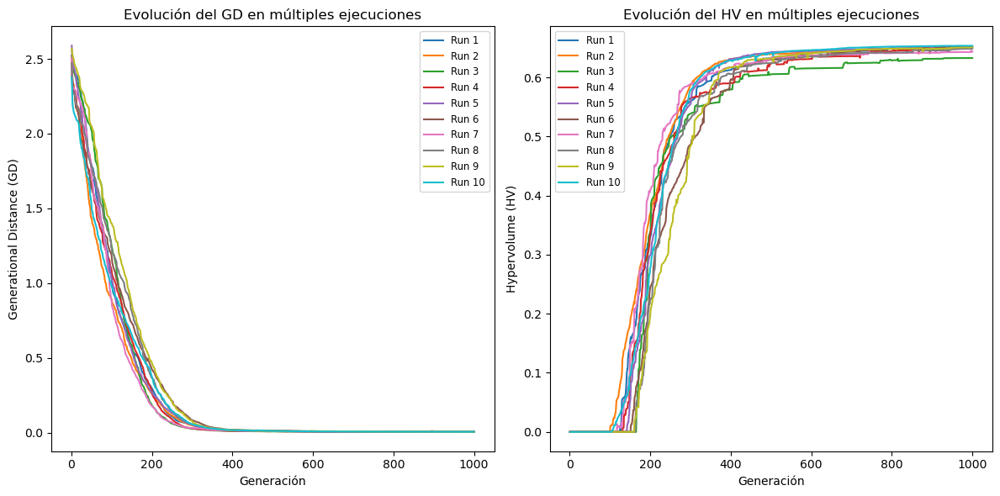

In [14]:
# Tchebycheff Decomposition
def tchebycheff_function(solution, weights, ideal_point):
    return np.max(weights * np.abs(solution - ideal_point))


# MOEA/D Initialization
def initialize_population(pop_size, n_vars, bounds):
    """
    Randomly initialize the population within given bounds.
    """
    lower_bounds, upper_bounds = bounds
    population = np.random.uniform(lower_bounds, upper_bounds, (pop_size, n_vars))
    return population


def initialize_weights(pop_size, n_objs):
    """
    Generate weight vectors for decomposition.
    """
    weights = np.random.dirichlet(np.ones(n_objs), size=pop_size)
    return weights


# Update Neighboring Solutions
def update_neighbors(population, obj_values, ideal_point, weights, neighbors, new_solution, new_obj_value):
    """
    Update the solutions in the neighborhood based on the Tchebycheff approach.
    """
    for i in neighbors:
        # Evaluate the Tchebycheff function for the current and new solutions
        current_tchebycheff = tchebycheff_function(obj_values[i], weights[i], ideal_point)
        new_tchebycheff = tchebycheff_function(new_obj_value, weights[i], ideal_point)
        # Replace the solution if the new one is better
        if new_tchebycheff < current_tchebycheff:
            population[i] = new_solution
            obj_values[i] = new_obj_value


def moead_with_metrics(n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size, pareto_front):
    """
    MOEA/D con cálculo de métricas GD, IGD y HV.
    """
    population = initialize_population(pop_size, n_vars, bounds)
    weights = initialize_weights(pop_size, n_objs)
    neighbors = [np.argsort(np.linalg.norm(weights - w, axis=1))[:neighborhood_size] for w in weights]
    ideal_point = np.min([evaluate_objectives(ind) for ind in population], axis=0)
    obj_values = np.array([evaluate_objectives(ind) for ind in population])

    # Inicialización de métricas
    gd_metric = GD(pareto_front)
    igd_metric = IGD(pareto_front)
    hv_metric = HV(ref_point=np.array([1.0, 1.0]))  # Punto de referencia para HV

    gd_values, igd_values, hv_values = [], [], []

    # Evolutionary Loop
    for _ in range(max_generations):
        for i in range(pop_size):
            parent_indices = np.random.choice(neighbors[i], 2, replace=False)
            parent1, parent2 = population[parent_indices[0]], population[parent_indices[1]]
            offspring = (parent1 + parent2) / 2
            mutation_prob = 1.0 / n_vars
            mutation_indices = np.random.rand(n_vars) < mutation_prob
            offspring[mutation_indices] += np.random.uniform(-0.1, 0.1, np.sum(mutation_indices))
            offspring = np.clip(offspring, bounds[0], bounds[1])
            new_obj_value = evaluate_objectives(offspring)
            ideal_point = np.minimum(ideal_point, new_obj_value)
            update_neighbors(population, obj_values, ideal_point, weights, neighbors[i], offspring, new_obj_value)

        # Calcular métricas
        gd_values.append(gd_metric(obj_values))
        igd_values.append(igd_metric(obj_values))
        hv_values.append(hv_metric(obj_values))

    return population, obj_values, gd_values, igd_values, hv_values

pareto_front = problem.pareto_front()

# Número de ejecuciones
num_runs = 10

# Parámetros
n_vars = 30
n_objs = 2
bounds = (np.zeros(n_vars), np.ones(n_vars))
pop_size = 100
max_generations = 1000
neighborhood_size = 10

# Almacenar métricas y soluciones de todas las ejecuciones
all_gd_values = []
all_igd_values = []
all_hv_values = []
best_solutions = []  # Para guardar la mejor población de cada ejecución
best_objective_values = []  # Valores objetivos asociados

# Ejecutar el algoritmo 10 veces
for run in range(num_runs):
    print(f"Run {run + 1}/{num_runs}")
    
    # Ejecutar MOEA/D
    final_population, final_obj_values, gd_values, igd_values, hv_values = moead_with_metrics(
        n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size, pareto_front
    )
    
    # Guardar métricas
    all_gd_values.append(gd_values)
    all_igd_values.append(igd_values)
    all_hv_values.append(hv_values)
    
# Calcular estadísticas
statistics = {
    "Estadístico": ["Mínimo", "Máximo", "Media", "Desviación Estándar", "Q1 (25%)", "Mediana (Q2, 50%)", "Q3 (75%)"],
    "GD": [
        np.min(all_gd_values),   # Mínimo
        np.max(all_gd_values),   # Máximo
        np.mean(all_gd_values),  # Media
        np.std(all_gd_values),   # Desviación estándar
        np.percentile(all_gd_values, 25),  # Q1
        np.percentile(all_gd_values, 50),  # Mediana (Q2)
        np.percentile(all_gd_values, 75),  # Q3
    ],
    "IGD": [
        np.min(all_igd_values),   # Mínimo
        np.max(all_igd_values),   # Máximo
        np.mean(all_igd_values),  # Media
        np.std(all_igd_values),   # Desviación estándar
        np.percentile(all_igd_values, 25),  # Q1
        np.percentile(all_igd_values, 50),  # Mediana (Q2)
        np.percentile(all_igd_values, 75),  # Q3
    ],
    "HV": [
        np.min(all_hv_values),   # Mínimo
        np.max(all_hv_values),   # Máximo
        np.mean(all_hv_values),  # Media
        np.std(all_hv_values),   # Desviación estándar
        np.percentile(all_hv_values, 25),  # Q1
        np.percentile(all_hv_values, 50),  # Mediana (Q2)
        np.percentile(all_hv_values, 75),  # Q3
    ]
}

# Crear la tabla
stats_df = pd.DataFrame(statistics)
print(stats_df)

# Graficar resultados
plt.figure(figsize=(12, 6))

# GD
plt.subplot(1, 2, 1)
for run in range(num_runs):
    plt.plot(range(1, max_generations + 1), all_gd_values[run], label=f"Run {run + 1}")
plt.xlabel("Generación")
plt.ylabel("Generational Distance (GD)")
plt.title("Evolución del GD en múltiples ejecuciones")
plt.legend(loc="best", fontsize="small")

# HV
plt.subplot(1, 2, 2)
for run in range(num_runs):
    plt.plot(range(1, max_generations + 1), all_hv_values[run], label=f"Run {run + 1}")
plt.xlabel("Generación")
plt.ylabel("Hypervolume (HV)")
plt.title("Evolución del HV en múltiples ejecuciones")
plt.legend(loc="best", fontsize="small")

plt.tight_layout()
plt.show()

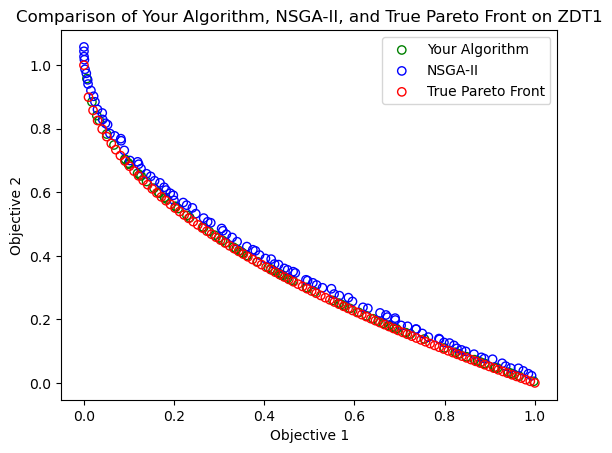

In [15]:
# Best Results
plt.scatter(final_obj_values[:, 0], final_obj_values[:, 1], label="Your Algorithm", color='g', marker='o', edgecolor='g', facecolor='none')
plt.scatter(res.F[:, 0], res.F[:, 1], label="NSGA-II", color='b', marker='o', edgecolor='b', facecolor='none')
plt.scatter(problem.pareto_front()[:, 0], problem.pareto_front()[:, 1], label="True Pareto Front", color='r', marker='o', edgecolor='r', facecolor='none')
plt.xlabel("Objective 1")
plt.ylabel("Objective 2")
plt.legend()
plt.title("Comparison of Your Algorithm, NSGA-II, and True Pareto Front on ZDT1")

plt.show()

---
## ZDT3

In [ ]:
from pymoo.indicators.igd import IGD
from pymoo.indicators.gd import GD
from pymoo.indicators.hv import HV
from pymoo.optimize import minimize
from pymoo.algorithms.moo.nsga2 import NSGA2

# Definir el problema ZDT3 
problem = get_problem("zdt3", n_var=30)
solution_range = [0, 1]

def create(solution_range=[0, 1], individual_variables=30, N=100):
    pop = np.empty([N, individual_variables])
    for i in range(N):
        ind = [random.uniform(solution_range[0], solution_range[1]) for _ in range(individual_variables)]
        pop[i] = ind
    return pop

def fit(population):
    fitness = problem.evaluate(population)
    return fitness

def sort_pop(pop, fit):
    fitness = fit(pop)
    pareto_front = pareto_rank(fitness)
    sorted_pop = np.array([pop[i] for i in pareto_front])
    sorted_fitness = np.array([fitness[i] for i in pareto_front])
    return sorted_pop, sorted_fitness

def pareto_rank(fitness):
    ranked = []
    for i in range(len(fitness)):
        rank = 0
        for j in range(len(fitness)):
            if i != j and dominates(fitness[j], fitness[i]):
                rank += 1
        ranked.append((i, rank))
    ranked.sort(key=lambda x: x[1])
    return [i[0] for i in ranked]

def dominates(f1, f2):
    return all(f1[i] <= f2[i] for i in range(len(f1))) and any(f1[i] < f2[i] for i in range(len(f1)))

def select(pop, T, fit):
    """
    Selección por torneo basada en el frente de Pareto.
    Selecciona al mejor individuo del torneo con T competidores.
    
    Args:
        pop (list): Población de individuos.
        T (int): Tamaño del torneo.
        fit (func): Función de evaluación de individuos.
        
    Returns:
        Individuo seleccionado (copia).
    """
    
    # Convertir población a lista si es un ndarray
    pop = pop.tolist() if isinstance(pop, np.ndarray) else pop

    # Seleccionar T individuos al azar de la población
    tournament = random.sample(pop, T)
    
    # Determinar el mejor individuo (menor suma de objetivos o primera métrica)
    # Aquí usamos la suma de valores objetivos como criterio de selección.
    best_individual = min(tournament, key=lambda ind: sum(fit(np.array([ind]))[0]))
    
    return copy.deepcopy(best_individual)


def crossover(ind1, ind2, pcross, alpha=0.5):
    """
    Crossover BLX-alpha para vectores continuos.

    Args:
        ind1, ind2: Padres (vectores).
        pcross: Probabilidad de cruce.
        alpha: Factor de mezcla. Por defecto 0.5 (punto medio).

    Returns:
        Hijos generados.
    """
    if random.random() < pcross:
        child1 = [(1 - alpha) * x1 + alpha * x2 for x1, x2 in zip(ind1, ind2)]
        child2 = [alpha * x1 + (1 - alpha) * x2 for x1, x2 in zip(ind1, ind2)]
        return child1, child2
    else:
        return ind1, ind2
    
def mutate(individual, pmut=0.1, delta_max=1):
    """
    Función de mutación simple para el problema ZDT1.

    :param individual: Lista de variables de un individuo.
    :param pmut: Probabilidad de mutación para cada variable (0.0 a 1.0).
    :param delta_max: El máximo cambio permitido en cada variable.
    :return: Nuevo individuo mutado.
    """
    for i in range(len(individual)):
        if random.random() < pmut:  # Aplicar mutación con probabilidad pmut
            delta = random.uniform(-delta_max, delta_max)  # Cambio aleatorio dentro del intervalo [-delta_max, delta_max]
            individual[i] = individual[i] + delta
            # Asegurar que los valores estén dentro del intervalo [0, 1]
            individual[i] = max(0, min(1, individual[i]))

    return individual

# Evolución del algoritmo
def evolve(pop, fit, pmut, pcross=0.7, ngen=100, T=2, elitism=False, verbose=False):
    pop, fitness = sort_pop(pop, fit)
    best = pop[0]
    metrics = {"IGD": [], "GD": [], "HV": []}

    # Inicialización de métricas
    igd_metric = IGD(problem.pareto_front())
    gd_metric = GD(problem.pareto_front())
    hv_metric = HV(ref_point=np.array([1.0, 1.0]))

    for gen in range(ngen):
        newpop = []
        if elitism:
            newpop.append(best)
        while len(newpop) < len(pop):
            ind1 = select(pop, T, fit)
            ind2 = select(pop, T, fit)
            child1, child2 = crossover(ind1, ind2, pcross=pcross)
            child1 = mutate(child1, pmut)
            child2 = mutate(child2, pmut)
            newpop.append(child1)
            newpop.append(child2)
        pop = np.array(newpop)
        pop, fitness = sort_pop(pop, fit)
        best = pop[0]

        # Calcular métricas
        pop_fitness = np.array([fit(ind) for ind in pop])
        igd_value = igd_metric(pop_fitness)
        gd_value = gd_metric(pop_fitness)
        hv_value = hv_metric(pop_fitness)

        metrics["IGD"].append(igd_value)
        metrics["GD"].append(gd_value)
        metrics["HV"].append(hv_value)

        if verbose:
            print(f"{gen+1:6} | {len(pop) * (gen+1):8} | {len(pop)} | {igd_value:.10f} | {gd_value:.10f} | {hv_value:.10e}")

    return pop, metrics

def plot_metrics(metrics):
    for metric_name, values in metrics.items():
        plt.figure(figsize=(8, 6))
        plt.plot(values, label=metric_name)
        plt.xlabel("Iteración")
        plt.ylabel("Valor")
        plt.title(f"Evolución de la métrica {metric_name}")
        plt.legend()
        plt.grid(True)
        plt.show()

In [ ]:
def run_algorithm(ngen, fit, pmut, pcross=0.7, N=100, T=2, elitism=False, verbose=False):
    individual_variables = 30  
    variable_range = [0, 1]    

    # Crear población inicial
    pop = create(variable_range, individual_variables, N)

    # Evolucionar la población
    best, metrics = evolve(
        pop, fit, pmut, pcross=pcross, ngen=ngen, T=T, elitism=elitism, verbose=verbose
    )
    return best, metrics


     1 |      200 | 200 | 2.2161731770 | 2.6295948291 | 0.0000000000e+00
     2 |      400 | 200 | 2.1207163199 | 2.4186458661 | 0.0000000000e+00
     3 |      600 | 200 | 2.2032371598 | 2.3800312171 | 0.0000000000e+00
     4 |      800 | 200 | 2.0161458711 | 2.3363605917 | 0.0000000000e+00
     5 |     1000 | 200 | 1.9937085556 | 2.1708209909 | 0.0000000000e+00
     6 |     1200 | 200 | 1.9497167659 | 2.1392980684 | 0.0000000000e+00
     7 |     1400 | 200 | 2.0140072045 | 2.1448619599 | 0.0000000000e+00
     8 |     1600 | 200 | 1.8660614881 | 2.1381546861 | 0.0000000000e+00
     9 |     1800 | 200 | 1.6839643518 | 2.0307900326 | 0.0000000000e+00
    10 |     2000 | 200 | 1.6939088199 | 2.1094878994 | 0.0000000000e+00
    11 |     2200 | 200 | 1.7852176274 | 2.0136271687 | 0.0000000000e+00
    12 |     2400 | 200 | 1.6388221311 | 1.8489999757 | 0.0000000000e+00
    13 |     2600 | 200 | 1.5026637423 | 1.8630897115 | 0.0000000000e+00
    14 |     2800 | 200 | 1.8983332091 | 1.83323662

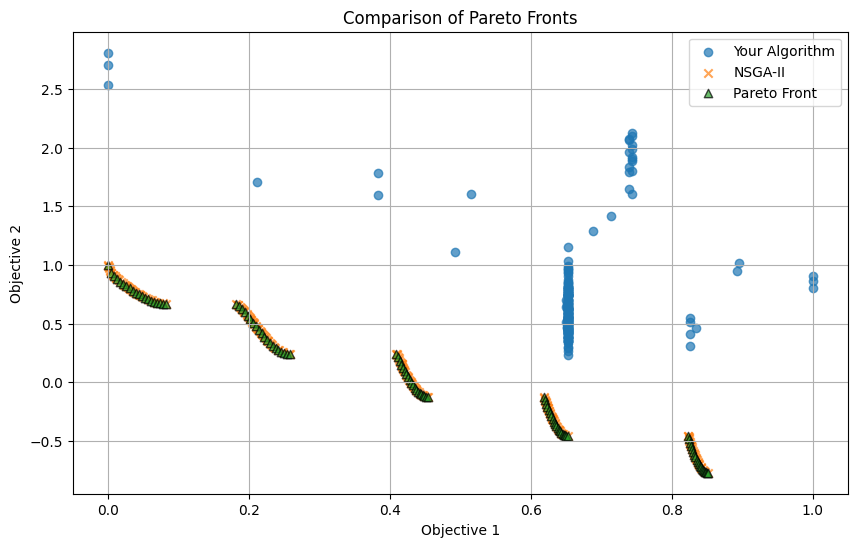

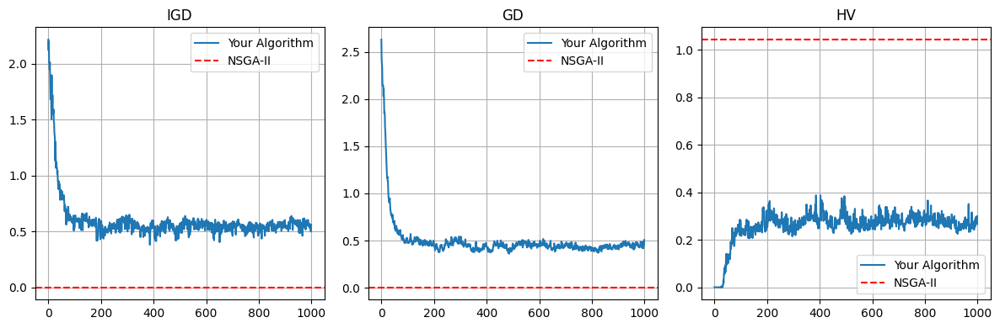

In [ ]:
def run_nsga2(problem, ngen=100, pop_size=100):
    algorithm = NSGA2(pop_size=pop_size)
    result = minimize(problem, algorithm, ('n_gen', ngen), verbose=True, save_history=True)
    return result

# Graficar
def plot_pareto(front1, front2, pareto_front=None, labels=("Your Algorithm", "NSGA-II", "Pareto Front"), title="Comparison of Pareto Fronts"):
    plt.figure(figsize=(10, 6))
    plt.scatter(front1[:, 0], front1[:, 1], label=labels[0], alpha=0.7)
    plt.scatter(front2[:, 0], front2[:, 1], label=labels[1], alpha=0.7, marker='x')
    if pareto_front is not None:
        plt.scatter(pareto_front[:, 0], pareto_front[:, 1], label=labels[2], alpha=0.7, marker='^', edgecolors='k')
    plt.title(title)
    plt.xlabel("Objective 1")
    plt.ylabel("Objective 2")
    plt.legend()
    plt.grid()
    plt.show()

# Parámetros
ngen = 1000  
pop_size = 200  
pmut = 2 / 30  
pcross = 0.7  

best, metrics = run_algorithm(ngen=ngen, fit=fit, pmut=pmut, pcross=pcross, N=pop_size, verbose=True)

nsga2_result = run_nsga2(problem, ngen=ngen, pop_size=pop_size)

pareto_front = problem.pareto_front()

plot_pareto(
    np.array([fit(ind) for ind in best]), 
    nsga2_result.F, 
    pareto_front=pareto_front, 
    labels=("Your Algorithm", "NSGA-II", "Pareto Front")
)

plt.figure(figsize=(12, 4))

# IGD
plt.subplot(1, 3, 1)
plt.plot(metrics["IGD"], label="Your Algorithm")
plt.axhline(y=IGD(pareto_front)(nsga2_result.F), color="red", linestyle="--", label="NSGA-II")
plt.title("IGD")
plt.legend()
plt.grid()

# GD
plt.subplot(1, 3, 2)
plt.plot(metrics["GD"], label="Your Algorithm")
plt.axhline(y=GD(pareto_front)(nsga2_result.F), color="red", linestyle="--", label="NSGA-II")
plt.title("GD")
plt.legend()
plt.grid()

# HV
plt.subplot(1, 3, 3)
plt.plot(metrics["HV"], label="Your Algorithm")
plt.axhline(y=HV(ref_point=np.array([1.0, 1.0]))(nsga2_result.F), color="red", linestyle="--", label="NSGA-II")
plt.title("HV")
plt.legend()
plt.grid()

plt.tight_layout()
plt.show()


In [ ]:
def evolve_with_statistics(fit, pmut, pcross=0.7, ngen=1000, N=100, T=10, elitism=False, verbose=False, iterations=10):
    bestGD = float('inf')
    bestPareto = []
    experiment_metrics = {"IGD": [], "GD": [], "HV": []}

    for _ in range(iterations):
        pop, metrics = run_algorithm(ngen, fit=fit, pmut=pmut, pcross=pcross, N=N, T=T, elitism=elitism, verbose=verbose)

        # Para cada experimento, metemos la iteración con mejor GD
        best_generation = metrics['GD'].index(min(metrics['GD']))

        for metric_name, values in metrics.items():
            experiment_metrics[metric_name].append(values[best_generation])

        if metrics['GD'][best_generation] < bestGD:
            bestGD = metrics['GD'][best_generation]
            bestPareto = pop

    statistics = {
        'minGD': min(experiment_metrics['GD']),
        'maxGD': max(experiment_metrics['GD']),
        'meanGD': np.mean(experiment_metrics['GD']),
        'medianGD': np.median(experiment_metrics['GD']),
        'CIGD': np.percentile(experiment_metrics['GD'], [2.5, 97.5]),
        'stdGD': np.std(experiment_metrics['GD']),

        'minIGD': min(experiment_metrics['IGD']),
        'maxIGD': max(experiment_metrics['IGD']),
        'meanIGD': np.mean(experiment_metrics['IGD']),
        'medianIGD': np.median(experiment_metrics['IGD']),
        'CIIGD': np.percentile(experiment_metrics['IGD'], [2.5, 97.5]),
        'stdIGD': np.std(experiment_metrics['IGD']),

        'minHV': min(experiment_metrics['HV']),
        'maxHV': max(experiment_metrics['HV']),
        'meanHV': np.mean(experiment_metrics['HV']),
        'medianHV': np.median(experiment_metrics['HV']),
        'CIHV': np.percentile(experiment_metrics['HV'], [2.5, 97.5]),
        'stdHV': np.std(experiment_metrics['HV']),
    }

    return bestPareto, statistics


In [ ]:
pop, stadistics = evolve_with_statistics(fit, 1/10, pcross=0.7, ngen=100, N = 100, T= 10, elitism=False, verbose=False, iterations = 10)
stadistics

{'minGD': np.float64(0.027950077206744514),
 'maxGD': np.float64(0.03689066117898637),
 'meanGD': np.float64(0.033009558049445296),
 'medianGD': np.float64(0.033744304364784816),
 'CIGD': array([0.02824072, 0.03664402]),
 'stdGD': np.float64(0.0029767060735185996),
 'minIGD': np.float64(0.11131580988637461),
 'maxIGD': np.float64(0.2686985106806248),
 'meanIGD': np.float64(0.19721525400049741),
 'medianIGD': np.float64(0.19001291815177346),
 'CIIGD': array([0.12134699, 0.26836623]),
 'stdIGD': np.float64(0.048105525760890826),
 'minHV': np.float64(0.5120778104860322),
 'maxHV': np.float64(0.8326968520531941),
 'meanHV': np.float64(0.6338763039119139),
 'medianHV': np.float64(0.6168366644885231),
 'CIHV': array([0.51771368, 0.8064561 ]),
 'stdHV': np.float64(0.09017567759166158)}

Generation 1/10000: Ideal Point = [0.01311118 2.31908308]
Generation 2/10000: Ideal Point = [0.01311118 2.31908308]
Generation 3/10000: Ideal Point = [0.01311118 2.31908308]
Generation 4/10000: Ideal Point = [0.01311118 2.31908308]
Generation 5/10000: Ideal Point = [0.01311118 2.31908308]
Generation 6/10000: Ideal Point = [0.01311118 2.31908308]
Generation 7/10000: Ideal Point = [0.01311118 2.31908308]
Generation 8/10000: Ideal Point = [0.01311118 2.31908308]
Generation 9/10000: Ideal Point = [0.01311118 2.31908308]
Generation 10/10000: Ideal Point = [0.01311118 2.27812593]
Generation 11/10000: Ideal Point = [0.01311118 2.19899339]
Generation 12/10000: Ideal Point = [0.01311118 2.15608732]
Generation 13/10000: Ideal Point = [0.01311118 2.1088749 ]
Generation 14/10000: Ideal Point = [0.01311118 2.09949592]
Generation 15/10000: Ideal Point = [0.01311118 2.06903527]
Generation 16/10000: Ideal Point = [0.01311118 2.03643397]
Generation 17/10000: Ideal Point = [0.01311118 2.02703744]
Genera

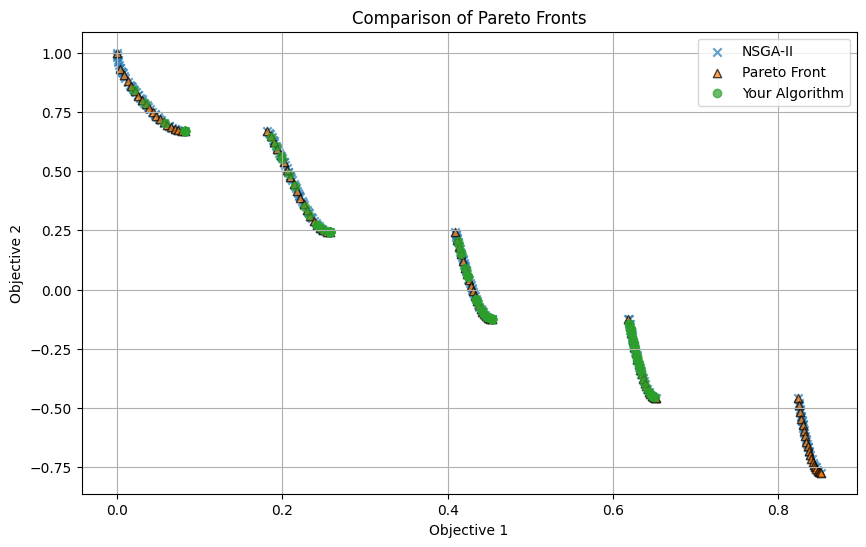

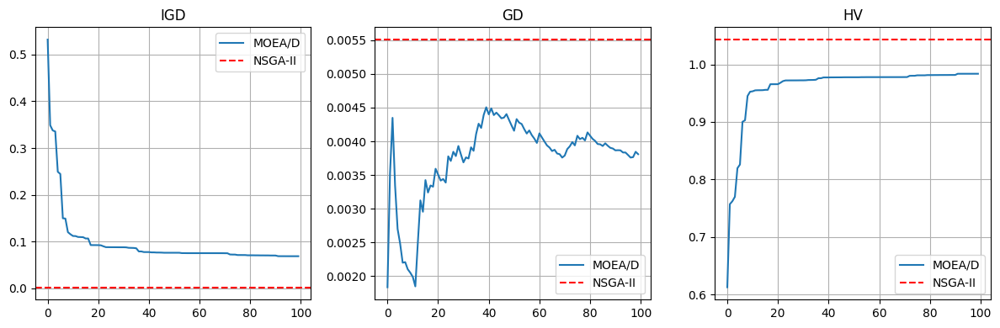

In [ ]:
#MOEA/D
from pymoo.indicators.igd import IGD
from pymoo.indicators.gd import GD
from pymoo.indicators.hv import HV
from pymoo.optimize import minimize
from pymoo.algorithms.moo.nsga2 import NSGA2
import numpy as np
import matplotlib.pyplot as plt

# Definir el problema ZDT3
problem = get_problem("zdt3", n_var=30)

# Funciones para MOEA/D
def evaluate_objectives(x):
    f1 = x[0]
    g = 1 + 9 * np.sum(x[1:]) / (len(x) - 1)
    h = 1 - np.sqrt(f1 / g) - (f1 / g) * np.sin(10 * np.pi * f1)
    f2 = g * h
    return np.array([f1, f2])

def tchebycheff_function(solution, weights, ideal_point):
    return np.max(weights * np.abs(solution - ideal_point))

def initialize_population(pop_size, n_vars, bounds):
    lower_bounds, upper_bounds = bounds
    return np.random.uniform(lower_bounds, upper_bounds, (pop_size, n_vars))

def initialize_weights(pop_size, n_objs):
    return np.random.dirichlet(np.ones(n_objs), size=pop_size)

def update_neighbors(population, obj_values, ideal_point, weights, neighbors, new_solution, new_obj_value):
    for i in neighbors:
        current_tchebycheff = tchebycheff_function(obj_values[i], weights[i], ideal_point)
        new_tchebycheff = tchebycheff_function(new_obj_value, weights[i], ideal_point)
        if new_tchebycheff < current_tchebycheff:
            population[i] = new_solution
            obj_values[i] = new_obj_value

def moead(n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size):
    population = initialize_population(pop_size, n_vars, bounds)
    weights = initialize_weights(pop_size, n_objs)
    neighbors = [np.argsort(np.linalg.norm(weights - w, axis=1))[:neighborhood_size] for w in weights]
    ideal_point = np.min([evaluate_objectives(ind) for ind in population], axis=0)
    obj_values = np.array([evaluate_objectives(ind) for ind in population])

    for generation in range(max_generations):
        for i in range(pop_size):
            parent_indices = np.random.choice(neighbors[i], 2, replace=False)
            parent1, parent2 = population[parent_indices[0]], population[parent_indices[1]]
            offspring = (parent1 + parent2) / 2
            mutation_prob = 1.0 / n_vars
            mutation_indices = np.random.rand(n_vars) < mutation_prob
            offspring[mutation_indices] += np.random.uniform(-0.1, 0.1, np.sum(mutation_indices))
            offspring = np.clip(offspring, bounds[0], bounds[1])
            new_obj_value = evaluate_objectives(offspring)
            ideal_point = np.minimum(ideal_point, new_obj_value)
            update_neighbors(population, obj_values, ideal_point, weights, neighbors[i], offspring, new_obj_value)

        print(f"Generation {generation + 1}/{max_generations}: Ideal Point = {ideal_point}")

    return population, obj_values

def run_nsga2(problem, ngen=100, pop_size=100):
    algorithm = NSGA2(pop_size=pop_size)
    result = minimize(problem, algorithm, ('n_gen', ngen), verbose=True, save_history=True)
    return result

# Graficar 
def plot_pareto(front1, front2, pareto_front=None, labels=("Your Algorithm", "NSGA-II", "Pareto Front"), title="Comparison of Pareto Fronts"):
    plt.figure(figsize=(10, 6))
    plt.scatter(front2[:, 0], front2[:, 1], label=labels[1], alpha=0.7, marker='x')
    if pareto_front is not None:
        plt.scatter(pareto_front[:, 0], pareto_front[:, 1], label=labels[2], alpha=0.7, marker='^', edgecolors='k') 
    plt.scatter(front1[:, 0], front1[:, 1], label=labels[0], alpha=0.7)
    plt.title(title)
    plt.xlabel("Objective 1")
    plt.ylabel("Objective 2")
    plt.legend()
    plt.grid()
    plt.show()

# Comparar métricas
def plot_metrics(final_obj_values, nsga2_result, pareto_front):
    igd_values = []
    gd_values = []
    hv_values = []

    for i in range(len(final_obj_values)):
        igd_values.append(IGD(pareto_front)(final_obj_values[:i+1])) 
        gd_values.append(GD(pareto_front)(final_obj_values[:i+1]))    
        hv_values.append(HV(ref_point=np.array([1.0, 1.0]))(final_obj_values[:i+1]))  

    plt.figure(figsize=(12, 4))

    # IGD
    plt.subplot(1, 3, 1)
    plt.plot(igd_values, label="MOEA/D")
    plt.axhline(y=IGD(pareto_front)(nsga2_result.F), color="red", linestyle="--", label="NSGA-II")
    plt.title("IGD")
    plt.legend()
    plt.grid()

    # GD
    plt.subplot(1, 3, 2)
    plt.plot(gd_values, label="MOEA/D")
    plt.axhline(y=GD(pareto_front)(nsga2_result.F), color="red", linestyle="--", label="NSGA-II")
    plt.title("GD")
    plt.legend()
    plt.grid()

    # HV
    plt.subplot(1, 3, 3)
    plt.plot(hv_values, label="MOEA/D")
    plt.axhline(y=HV(ref_point=np.array([1.0, 1.0]))(nsga2_result.F), color="red", linestyle="--", label="NSGA-II")
    plt.title("HV")
    plt.legend()
    plt.grid()

    plt.tight_layout()
    plt.show()


# Parámetros
n_vars = 30
n_objs = 2
bounds = (np.zeros(n_vars), np.ones(n_vars))
pop_size = 100
max_generations = 10000
neighborhood_size = 10

final_population, final_obj_values = moead(n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size)

nsga2_result = run_nsga2(problem, ngen=1000, pop_size=200)

pareto_front = problem.pareto_front()

plot_pareto(final_obj_values, nsga2_result.F, pareto_front=pareto_front)

plot_metrics(final_obj_values, nsga2_result, pareto_front)


In [ ]:
def moead_with_statistics(n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size, iterations=10):
    bestGD = float('inf')
    bestPareto = []
    experiment_metrics = {"IGD": [], "GD": [], "HV": []}

    for _ in range(iterations):
        final_population, final_obj_values = moead(n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size)

        # Obtener las métricas para cada generación final
        igd_value = IGD(pareto_front)(final_obj_values)
        gd_value = GD(pareto_front)(final_obj_values)
        hv_value = HV(ref_point=np.array([1.0, 1.0]))(final_obj_values)

        experiment_metrics["IGD"].append(igd_value)
        experiment_metrics["GD"].append(gd_value)
        experiment_metrics["HV"].append(hv_value)

        if gd_value < bestGD:
            bestGD = gd_value
            bestPareto = final_population

    # Calcular estadísticas
    statistics = {
        'minGD': min(experiment_metrics['GD']),
        'maxGD': max(experiment_metrics['GD']),
        'meanGD': np.mean(experiment_metrics['GD']),
        'medianGD': np.median(experiment_metrics['GD']),
        'CIGD': np.percentile(experiment_metrics['GD'], [2.5, 97.5]),
        'stdGD': np.std(experiment_metrics['GD']),

        'minIGD': min(experiment_metrics['IGD']),
        'maxIGD': max(experiment_metrics['IGD']),
        'meanIGD': np.mean(experiment_metrics['IGD']),
        'medianIGD': np.median(experiment_metrics['IGD']),
        'CIIGD': np.percentile(experiment_metrics['IGD'], [2.5, 97.5]),
        'stdIGD': np.std(experiment_metrics['IGD']),

        'minHV': min(experiment_metrics['HV']),
        'maxHV': max(experiment_metrics['HV']),
        'meanHV': np.mean(experiment_metrics['HV']),
        'medianHV': np.median(experiment_metrics['HV']),
        'CIHV': np.percentile(experiment_metrics['HV'], [2.5, 97.5]),
        'stdHV': np.std(experiment_metrics['HV'])
    }

    return bestPareto, statistics


In [ ]:
bestPareto, statistics = moead_with_statistics(
    n_vars=30, 
    n_objs=2, 
    bounds=(np.zeros(30), np.ones(30)), 
    pop_size=100, 
    max_generations=10000, 
    neighborhood_size=10, 
    iterations=10
)
statistics

Generation 1/10000: Ideal Point = [0.00903777 1.86007222]
Generation 2/10000: Ideal Point = [0.00903777 1.86007222]
Generation 3/10000: Ideal Point = [0.00903777 1.86007222]
Generation 4/10000: Ideal Point = [0.00903777 1.86007222]
Generation 5/10000: Ideal Point = [0.00903777 1.86007222]
Generation 6/10000: Ideal Point = [0.00903777 1.86007222]
Generation 7/10000: Ideal Point = [0.00903777 1.86007222]
Generation 8/10000: Ideal Point = [0.00903777 1.86007222]
Generation 9/10000: Ideal Point = [0.00903777 1.86007222]
Generation 10/10000: Ideal Point = [0.00903777 1.86007222]
Generation 11/10000: Ideal Point = [0.00903777 1.86007222]
Generation 12/10000: Ideal Point = [0.00903777 1.86007222]
Generation 13/10000: Ideal Point = [0.00903777 1.86007222]
Generation 14/10000: Ideal Point = [0.00903777 1.86007222]
Generation 15/10000: Ideal Point = [0.00903777 1.86007222]
Generation 16/10000: Ideal Point = [0.00903777 1.86007222]
Generation 17/10000: Ideal Point = [0.00903777 1.86007222]
Genera

{'minGD': np.float64(0.003588971605869137),
 'maxGD': np.float64(0.005120160089726331),
 'meanGD': np.float64(0.0044102611109804015),
 'medianGD': np.float64(0.0044728891654316535),
 'CIGD': array([0.00360805, 0.0050993 ]),
 'stdGD': np.float64(0.000497369293305702),
 'minIGD': np.float64(0.06885890452203276),
 'maxIGD': np.float64(0.42321337105908363),
 'meanIGD': np.float64(0.25396467428757263),
 'medianIGD': np.float64(0.20226197617527697),
 'CIIGD': array([0.09815595, 0.42272819]),
 'stdIGD': np.float64(0.11601418777518868),
 'minHV': np.float64(0.6506748529043114),
 'maxHV': np.float64(0.9809332120437434),
 'meanHV': np.float64(0.8096277487001527),
 'medianHV': np.float64(0.8582383278250879),
 'CIHV': array([0.65095631, 0.95436758]),
 'stdHV': np.float64(0.10885274991564112)}

---
## MW7

In [9]:
# Definir el problema MW7 usando pymoo
problem = get_problem("mw7", n_var=30)

# Problem Definition
def evaluate_objectives(population):
    return np.array([problem.evaluate(ind)[0] for ind in population])

def evaluate_objectives_restriction(individual):
    return problem.evaluate(individual)

# Operadores evolutivos
def select(pop, T, fit):
    """
    Selección por torneo basada en el frente de Pareto.
    """
    tournament = random.sample(pop, T)
    best_individual = min(tournament, key=lambda ind: sum(fit(ind)))
    return copy.deepcopy(best_individual)

def crossover(ind1, ind2, pcross, alpha=0.5):
    """
    Crossover BLX-alpha para vectores continuos.
    """
    if random.random() < pcross:
        child1 = [(1 - alpha) * x1 + alpha * x2 for x1, x2 in zip(ind1, ind2)]
        child2 = [alpha * x1 + (1 - alpha) * x2 for x1, x2 in zip(ind1, ind2)]
        return np.clip(child1, 0, 1), np.clip(child2, 0, 1)
    else:
        return ind1, ind2

def mutate(individual, pmut=0.1, delta_max=0.1):
    """
    Función de mutación simple para el problema MW7.
    """
    for i in range(len(individual)):
        if random.random() < pmut:
            delta = random.uniform(-delta_max, delta_max)
            individual[i] += delta
            individual[i] = np.clip(individual[i], 0, 1)
    return individual

# Algoritmo MOGA
def moga(n_vars, n_objs, bounds, pop_size, max_generations, T, pcross=0.9, pmut=0.1, verbose=True):
    """
    Algoritmo MOGA con selección por torneo, crossover BLX-alpha y mutación simple.
    """
    # Initialize metrics
    metrics = {"IGD": [], "GD": [], "HV": []}
    igd_metric = IGD(problem.pareto_front())
    gd_metric = GD(problem.pareto_front())
    hv_metric = HV(ref_point=np.array([1.2, 1.2]))

    # Step 1: Inicialización
    lower_bounds, upper_bounds = bounds
    population = [np.random.uniform(lower_bounds, upper_bounds, n_vars) for _ in range(pop_size)]
    fitness = evaluate_objectives(population)

    # Step 2: Bucle evolutivo
    for generation in range(max_generations):
        new_population = []
        for _ in range(pop_size // 2):
            # Selección
            parent1 = select(population, T, lambda ind: problem.evaluate(ind)[0])
            parent2 = select(population, T, lambda ind: problem.evaluate(ind)[0])

            # Crossover
            child1, child2 = crossover(parent1, parent2, pcross)

            # Mutación
            child1 = mutate(child1, pmut)
            child2 = mutate(child2, pmut)

            # Evaluar restricciones
            child1_obj, child1_res = evaluate_objectives_restriction(child1)
            child2_obj, child2_res = evaluate_objectives_restriction(child2)

            if child1_res[0] >= 0 and child1_res[1] <= 0:
                new_population.append(child1)
            if child2_res[0] >= 0 and child2_res[1] <= 0:
                new_population.append(child2)

        # Reemplazar la población
        population = new_population[:pop_size]
        fitness = evaluate_objectives(population)

        # Calcular métricas
        igd_value = igd_metric(fitness)
        gd_value = gd_metric(fitness)
        metrics["IGD"].append(igd_value)
        metrics["GD"].append(gd_value)
        metrics["HV"].append(hv_metric(fitness))


        if verbose:
            print(f"Generación {generation+1:3} | IGD: {igd_value:.10f} | GD: {gd_value:.10f} | HV: {metrics['HV'][-1]:.10e}")

    return population, metrics

# Parámetros
n_vars = 30
n_objs = 2
bounds = (np.zeros(n_vars), np.ones(n_vars))
pop_size = 100
max_generations = 100
T = 5

# Ejecutar MOGA
final_population, metrics = moga(n_vars, n_objs, bounds, pop_size, max_generations, T)

# Resultados
final_obj_values = evaluate_objectives(final_population)
print("Final Population:")
print(final_population)
print("Final Objective Values:")
print(final_obj_values)


Generación   1 | IGD: 8.8258988146 | GD: 12.0009680726 | HV: 0.0000000000e+00
Generación   2 | IGD: 8.9985735733 | GD: 10.1467892164 | HV: 0.0000000000e+00
Generación   3 | IGD: 8.6704465231 | GD: 9.7881767492 | HV: 0.0000000000e+00
Generación   4 | IGD: 8.6593692933 | GD: 9.5024190888 | HV: 0.0000000000e+00
Generación   5 | IGD: 8.8950832036 | GD: 9.4376690579 | HV: 0.0000000000e+00
Generación   6 | IGD: 8.8590249452 | GD: 9.2877497135 | HV: 0.0000000000e+00
Generación   7 | IGD: 8.8352315730 | GD: 8.9315979397 | HV: 0.0000000000e+00
Generación   8 | IGD: 8.3632191724 | GD: 8.7745196529 | HV: 0.0000000000e+00
Generación   9 | IGD: 8.3679405217 | GD: 8.5638137977 | HV: 0.0000000000e+00
Generación  10 | IGD: 8.3928701981 | GD: 8.3751714722 | HV: 0.0000000000e+00
Generación  11 | IGD: 8.0667021898 | GD: 8.1483839310 | HV: 0.0000000000e+00
Generación  12 | IGD: 7.9329256259 | GD: 7.9610332736 | HV: 0.0000000000e+00
Generación  13 | IGD: 7.6667695220 | GD: 7.7711029232 | HV: 0.0000000000e+

n_gen  |  n_eval  | n_nds  |     cv_min    |     cv_avg    |      igd      |       gd      |       hv     
     1 |      100 |      1 |  6.001978E+01 |  2.601881E+02 |             - |             - |             -
     2 |      200 |      1 |  5.884099E+01 |  1.738643E+02 |             - |             - |             -
     3 |      300 |      1 |  4.054617E+01 |  1.224136E+02 |             - |             - |             -
     4 |      400 |      1 |  2.477210E+01 |  8.802425E+01 |             - |             - |             -
     5 |      500 |      1 |  2.477210E+01 |  5.960234E+01 |             - |             - |             -
     6 |      600 |      1 |  1.761482E+01 |  4.094968E+01 |             - |             - |             -
     7 |      700 |      1 |  1.461692E+01 |  2.955112E+01 |             - |             - |             -
     8 |      800 |      1 |  1.256440E+01 |  2.282166E+01 |             - |             - |             -
     9 |      900 |      1 |  1.07928

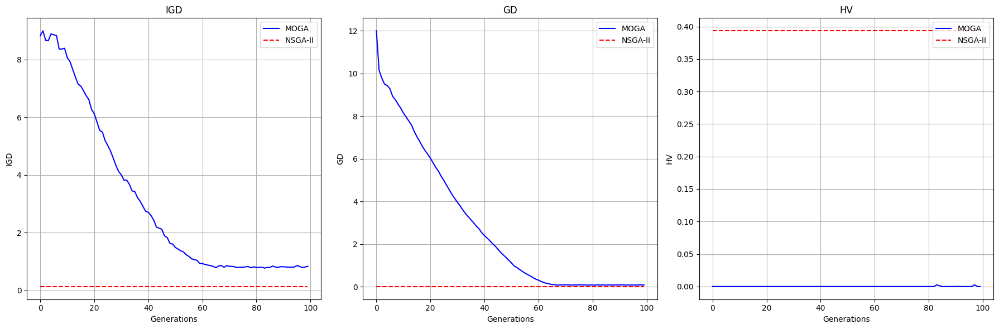

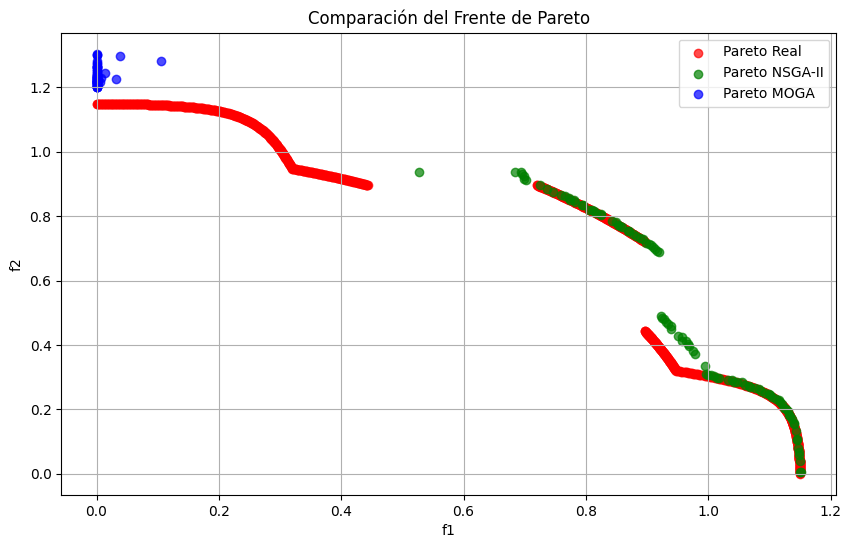

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from pymoo.algorithms.moo.nsga2 import NSGA2
from pymoo.optimize import minimize
from pymoo.problems import get_problem

# Frente de Pareto real
pareto_real = problem.pareto_front()

# Configuración para NSGA-II
def run_nsga2(problem, ngen=100, pop_size=100):
    algorithm = NSGA2(pop_size=pop_size)
    result = minimize(problem, algorithm, ('n_gen', ngen), verbose=True)
    return result

# Ejecutar NSGA-II
nsga2_result = run_nsga2(problem, ngen=max_generations, pop_size=pop_size)
pareto_nsga2 = nsga2_result.F

# Calcular métricas para NSGA-II
igd_metric_nsga2 = IGD(pareto_real)
gd_metric_nsga2 = GD(pareto_real)
hv_metric_nsga2 = HV(ref_point=np.array([1.2, 1.2]))

metrics_nsga2 = {
    "IGD": [igd_metric_nsga2(pareto_nsga2)],
    "GD": [gd_metric_nsga2(pareto_nsga2)],
    "HV": [hv_metric_nsga2(pareto_nsga2)]
}

# Función para graficar métricas
def plot_metrics(metrics_moga, metrics_nsga2):
    generations = range(len(metrics_moga["IGD"]))

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    metric_names = ["IGD", "GD", "HV"]

    for i, metric in enumerate(metric_names):
        axs[i].plot(generations, metrics_moga[metric], label="MOGA", color="blue")
        axs[i].hlines(metrics_nsga2[metric], xmin=0, xmax=max(generations), label="NSGA-II", color="red", linestyle="--")
        axs[i].set_title(metric)
        axs[i].set_xlabel("Generations")
        axs[i].set_ylabel(metric)
        axs[i].legend()
        axs[i].grid(True)

    plt.tight_layout()
    plt.show()

# Graficar las métricas comparativas
plot_metrics(metrics, metrics_nsga2)

# Comparar los frentes de Pareto
plt.figure(figsize=(10, 6))
plt.scatter(pareto_real[:, 0], pareto_real[:, 1], c="red", label="Pareto Real", alpha=0.7)
plt.scatter(pareto_nsga2[:, 0], pareto_nsga2[:, 1], c="green", label="Pareto NSGA-II", alpha=0.7)
plt.scatter(final_obj_values[:, 0], final_obj_values[:, 1], c="blue", label="Pareto MOGA", alpha=0.7)
plt.xlabel("f1")
plt.ylabel("f2")
plt.title("Comparación del Frente de Pareto")
plt.legend()
plt.grid(True)
plt.show()


In [11]:
import pandas as pd

# Realizar múltiples ejecuciones del algoritmo
n_runs = 10  # Número de ejecuciones
all_metrics = {"GD": [], "IGD": [], "HV": []}

for run in range(n_runs):
    print(f"Ejecutando MOGA - Ejecución {run+1}")
    _, metrics = moga(n_vars, n_objs, bounds, pop_size, max_generations, T, verbose=False)
    all_metrics["GD"].append(metrics["GD"][-1])  # Guardar el último GD de esta ejecución
    all_metrics["IGD"].append(metrics["IGD"][-1])  # Guardar el último IGD de esta ejecución
    all_metrics["HV"].append(metrics["HV"][-1])  # Guardar el último HV de esta ejecución

# Calcular estadísticas
summary_stats = {
    "Métrica": ["GD", "IGD", "HV"],
    "Mín": [np.min(all_metrics["GD"]), np.min(all_metrics["IGD"]), np.min(all_metrics["HV"])],
    "Máx": [np.max(all_metrics["GD"]), np.max(all_metrics["IGD"]), np.max(all_metrics["HV"])],
    "Media": [np.mean(all_metrics["GD"]), np.mean(all_metrics["IGD"]), np.mean(all_metrics["HV"])],
    "Std": [np.std(all_metrics["GD"]), np.std(all_metrics["IGD"]), np.std(all_metrics["HV"])],
}

# Convertir a DataFrame para presentación
df_summary = pd.DataFrame(summary_stats)

# Mostrar la tabla
print(df_summary)

Ejecutando MOGA - Ejecución 1
Ejecutando MOGA - Ejecución 2
Ejecutando MOGA - Ejecución 3
Ejecutando MOGA - Ejecución 4
Ejecutando MOGA - Ejecución 5
Ejecutando MOGA - Ejecución 6
Ejecutando MOGA - Ejecución 7
Ejecutando MOGA - Ejecución 8
Ejecutando MOGA - Ejecución 9
Ejecutando MOGA - Ejecución 10
  Métrica       Mín       Máx     Media       Std
0      GD  0.077953  0.088100  0.082096  0.003236
1     IGD  0.781242  0.862716  0.813189  0.026668
2      HV  0.000000  0.001799  0.000240  0.000550


In [12]:
# Definir el problema MW14 usando pymoo
problem = get_problem("mw7", n_var=30)
solution_range = [0,1]

# Problem Definition

def evaluate_objectives(population):
    fitness = problem.evaluate(population)[0]
    return fitness

def evaluate_objectives_restriction(population):
    fitness,constraints = problem.evaluate(population)
    return fitness,constraints



# Tchebycheff Decomposition
def tchebycheff_function(solution, weights, ideal_point):
    return np.max(weights * np.abs(solution - ideal_point))


# MOEA/D Initialization
def initialize_population(pop_size, n_vars, bounds):
    """
    Randomly initialize the population within given bounds.
    """
    lower_bounds, upper_bounds = bounds
    population = np.random.uniform(lower_bounds, upper_bounds, (pop_size, n_vars))
    return population


def initialize_weights(pop_size, n_objs):
    """
    Generate weight vectors for decomposition.
    """
    weights = np.random.dirichlet(np.ones(n_objs), size=pop_size)
    return weights


# Update Neighboring Solutions
def update_neighbors(population, obj_values, ideal_point, weights, neighbors, new_solution, new_obj_value):
    """
    Update the solutions in the neighborhood based on the Tchebycheff approach.
    """
    for i in neighbors:
        # Evaluate the Tchebycheff function for the current and new solutions
        current_tchebycheff = tchebycheff_function(obj_values[i], weights[i], ideal_point)
        new_tchebycheff = tchebycheff_function(new_obj_value, weights[i], ideal_point)
        # Replace the solution if the new one is better
        if new_tchebycheff < current_tchebycheff:
            population[i] = new_solution
            obj_values[i] = new_obj_value


# Main MOEA/D Algorithm
def moead(n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size, verbose = True):
    """
    Main MOEA/D function.
    """
    # Initialize metrics
    metrics = {"IGD": [], "GD": [], "HV": []}

    # Inicialización de métricas
    igd_metric = IGD(problem.pareto_front())
    gd_metric = GD(problem.pareto_front())
    hv_metric = HV(ref_point=np.array([1.2, 1.2]))  


    # Step 1: Initialization
    population = initialize_population(pop_size, n_vars, bounds)
    weights = initialize_weights(pop_size, n_objs)
    neighbors = [np.argsort(np.linalg.norm(weights - w, axis=1))[:neighborhood_size] for w in weights]
    ideal_point = np.min([evaluate_objectives(ind) for ind in population], axis=0)
    obj_values = np.array([evaluate_objectives(ind) for ind in population])

    # Step 2: Evolutionary Loop
    for generation in range(max_generations):
        for i in range(pop_size):
            # Select two random parents from the neighborhood
            parent_indices = np.random.choice(neighbors[i], 2, replace=False)
            parent1, parent2 = population[parent_indices[0]], population[parent_indices[1]]
            
            # Crossover (SBX or BLX-alpha crossover can be used here)
            offspring = (parent1 + parent2) / 2  # Simple arithmetic crossover
            
            # Mutation
            mutation_prob = 1.0 / n_vars
            mutation_indices = np.random.rand(n_vars) < mutation_prob
            offspring[mutation_indices] += np.random.uniform(-0.1, 0.1, np.sum(mutation_indices))
            offspring = np.clip(offspring, bounds[0], bounds[1])  # Ensure within bounds
            
            # Evaluate objectives
            new_obj_value,restriction = evaluate_objectives_restriction(offspring)
            if restriction[0] >= 0 and restriction[1] <= 0:
                # Update the ideal point
                ideal_point = np.minimum(ideal_point, new_obj_value)
                
                # Update the neighborhood
                update_neighbors(population, obj_values, ideal_point, weights, neighbors[i], offspring, new_obj_value)

        # Mostrar métricas cada generación
        # Calcular métricas
        pop_fitness = evaluate_objectives(population)  # Asegurarse de que sea un np.array 2D
        igd_value = igd_metric(pop_fitness)
        gd_value = gd_metric(pop_fitness)
        hv_value = hv_metric(pop_fitness)

        metrics["IGD"].append(igd_value)
        metrics["GD"].append(gd_value)
        metrics["HV"].append(hv_value)

        
        if verbose:
            print(f"{generation+1:6} | {len(population) * (generation+1):8} | {len(population)} | {igd_value:.10f} | {gd_value:.10f} | {hv_value:.10e}")

    return population, metrics


# Parámetros del problema
n_vars = 30
n_objs = 2
bounds = (np.zeros(n_vars), np.ones(n_vars))
pop_size = 100
max_generations = 100
neighborhood_size = 10
n_runs = 10  # Número de ejecuciones

# Inicializar un diccionario para guardar las métricas de cada ejecución
all_metrics = {"IGD": [], "GD": [], "HV": []}

# Ejecutar el algoritmo MOEA/D 10 veces
for run in range(n_runs):
    print(f"Ejecutando MOEA/D - Ejecución {run+1}")
    final_population, metrics = moead(
        n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size, verbose=False
    )
    
    # Guardar las métricas finales (última generación) de esta ejecución
    all_metrics["IGD"].append(metrics["IGD"][-1])
    all_metrics["GD"].append(metrics["GD"][-1])
    all_metrics["HV"].append(metrics["HV"][-1])

# Calcular estadísticas para las métricas
summary_stats = {
    "Métrica": ["IGD", "GD", "HV"],
    "Mín": [np.min(all_metrics["IGD"]), np.min(all_metrics["GD"]), np.min(all_metrics["HV"])],
    "Máx": [np.max(all_metrics["IGD"]), np.max(all_metrics["GD"]), np.max(all_metrics["HV"])],
    "Media": [np.mean(all_metrics["IGD"]), np.mean(all_metrics["GD"]), np.mean(all_metrics["HV"])],
    "Std": [np.std(all_metrics["IGD"]), np.std(all_metrics["GD"]), np.std(all_metrics["HV"])],
}

# Convertir las estadísticas a un DataFrame para una presentación clara
df_summary = pd.DataFrame(summary_stats)

# Mostrar la tabla en consola
print("\nResumen de métricas (estadísticas):")
print(df_summary)

# Run MOEA/D
final_population, metrics = moead(n_vars, n_objs, bounds, pop_size, max_generations, neighborhood_size)
final_obj_values = evaluate_objectives(final_population)


Ejecutando MOEA/D - Ejecución 1
Ejecutando MOEA/D - Ejecución 2
Ejecutando MOEA/D - Ejecución 3
Ejecutando MOEA/D - Ejecución 4
Ejecutando MOEA/D - Ejecución 5
Ejecutando MOEA/D - Ejecución 6
Ejecutando MOEA/D - Ejecución 7
Ejecutando MOEA/D - Ejecución 8
Ejecutando MOEA/D - Ejecución 9
Ejecutando MOEA/D - Ejecución 10

Resumen de métricas (estadísticas):
  Métrica       Mín       Máx     Media       Std
0     IGD  0.123870  0.833492  0.342967  0.284016
1      GD  0.050037  0.453955  0.146309  0.146070
2      HV  0.000432  0.244961  0.160821  0.102657
     1 |      100 | 100 | 10.0575139544 | 12.0485819981 | 0.0000000000e+00
     2 |      200 | 100 | 9.7791197022 | 11.5607562340 | 0.0000000000e+00
     3 |      300 | 100 | 9.5846708589 | 11.3463847562 | 0.0000000000e+00
     4 |      400 | 100 | 9.2083707740 | 10.9506752070 | 0.0000000000e+00
     5 |      500 | 100 | 8.7515356998 | 10.7574272993 | 0.0000000000e+00
     6 |      600 | 100 | 8.5194552388 | 10.5018408227 | 0.0000000000e+

In [13]:
def plot_metrics(metrics_moead):
    generations = range(len(metrics_moead["IGD"]))

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    metric_names = ["IGD", "GD", "HV"]

    for i, metric in enumerate(metric_names):
        axs[i].plot(generations, metrics_moead[metric], label="MOEA/D", color="blue")
        axs[i].hlines(metrics_nsga2[metric], xmin=0, xmax=max(generations), label="NSGA-II", color="red", linestyle="--")
        axs[i].set_title(metric)
        axs[i].set_xlabel("Generations")
        axs[i].set_ylabel(metric)
        axs[i].legend()
        axs[i].grid(True)

    plt.tight_layout()
    plt.show()

n_gen  |  n_eval  | n_nds  |     cv_min    |     cv_avg    |      igd      |       gd      |       hv     
     1 |      100 |      1 |  1.167103E+02 |  2.795873E+02 |             - |             - |             -
     2 |      200 |      1 |  6.515729E+01 |  1.968586E+02 |             - |             - |             -
     3 |      300 |      1 |  6.515729E+01 |  1.527008E+02 |             - |             - |             -
     4 |      400 |      1 |  4.563679E+01 |  1.166660E+02 |             - |             - |             -
     5 |      500 |      1 |  3.012330E+01 |  8.779470E+01 |             - |             - |             -
     6 |      600 |      1 |  2.205549E+01 |  6.287118E+01 |             - |             - |             -
     7 |      700 |      1 |  1.207289E+01 |  4.413588E+01 |             - |             - |             -
     8 |      800 |      1 |  8.2275002384 |  3.084324E+01 |             - |             - |             -
     9 |      900 |      1 |  7.54107

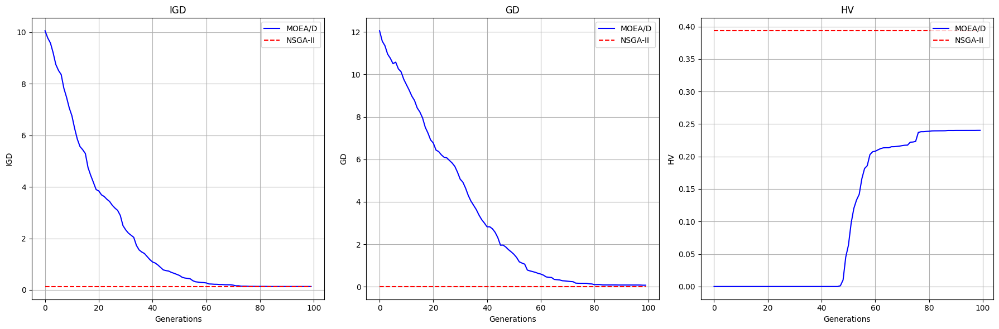

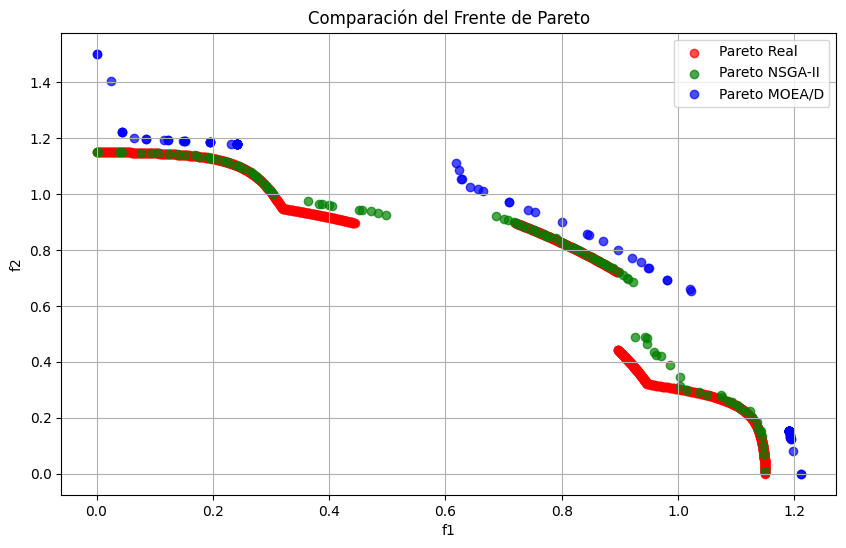

In [14]:
# Frente de Pareto real
pareto_real = problem.pareto_front()

# Configuración para NSGA-II
def run_nsga2(problem, ngen=100, pop_size=100):
    algorithm = NSGA2(pop_size=pop_size)
    result = minimize(problem, algorithm, ('n_gen', ngen), verbose=True)
    return result

# Ejecutar NSGA-II
nsga2_result = run_nsga2(problem, ngen=100, pop_size=100)
pareto_nsga2 = nsga2_result.F

# Frente de Pareto obtenido por MOEA/D (final_obj_values ya contiene los valores)
pareto_moead = final_obj_values

# Visualizar la evolucion de las metricas
plot_metrics(metrics)

# Graficar la comparación
plt.figure(figsize=(10, 6))
plt.scatter(pareto_real[:, 0], pareto_real[:, 1], c='red', label='Pareto Real', alpha=0.7)
plt.scatter(pareto_nsga2[:, 0], pareto_nsga2[:, 1], c='green', label='Pareto NSGA-II', alpha=0.7)
plt.scatter(pareto_moead[:, 0], pareto_moead[:, 1], c='blue', label='Pareto MOEA/D', alpha=0.7)
plt.xlabel('f1')
plt.ylabel('f2')
plt.title('Comparación del Frente de Pareto')
plt.legend()
plt.grid(True)
plt.show()


---
## MW14

In [ ]:
# Mejores resultado para NSGA2
# Inicialización de métricas
# Definir el problema MW14 usando pymoo
problem = get_problem("mw14", n_var=30)
solution_range = [0,1.5]

igd_metric = IGD(problem.pareto_front())
gd_metric = GD(problem.pareto_front())
hv_metric = HV(ref_point=np.array([1.5, 1.5, 5])) 

# Ejecutar NSGA-II usando pymoo
algorithm = NSGA2(pop_size=100)
print("Ejecutando NSGA-II...")
res = minimize(problem, algorithm, termination=('n_gen', 1000), verbose=False)

igd_value = igd_metric(res.F)
gd_value = gd_metric(res.F)
hv_value = hv_metric(res.F)

nsga2_metrics = {'IGD':igd_value,'GD':gd_value,'HV':hv_value}
print(f"gd_val: {gd_value} \n igd_val: {igd_value} \n hv_val: {hv_value}")

Ejecutando NSGA-II...
gd_val: 0.09012523804382251 
 igd_val: 0.1767415984610324 
 hv_val: 3.6586110144128767


### Usando MOGA ###

In [ ]:

# Definir el problema MW14 usando pymoo
problem = get_problem("mw14", n_var=30)
solution_range = [0,1.5]

def select(pop, T, fit):
    """
    Selección por torneo basada en el frente de Pareto.
    Selecciona al mejor individuo del torneo con T competidores.

    Args:
        pop (list): Población de individuos.
        T (int): Tamaño del torneo.
        fit (func): Función de evaluación de individuos.

    Returns:
        Individuo seleccionado (copia).
    """
    # Seleccionar T individuos al azar de la población
    tournament = random.sample(pop, T)

    best_individual = min(tournament, key=lambda ind: sum(fit(ind)))

    return copy.deepcopy(best_individual)


def crossover(ind1, ind2, pcross, alpha=0.5):
    """
    Crossover BLX-alpha para vectores continuos.

    Args:
        ind1, ind2: Padres (vectores).
        pcross: Probabilidad de cruce.
        alpha: Factor de mezcla. Por defecto 0.5 (punto medio).

    Returns:
        Hijos generados.
    """
    if random.random() < pcross:
        child1 = [(1 - alpha) * x1 + alpha * x2 for x1, x2 in zip(ind1, ind2)]
        child2 = [alpha * x1 + (1 - alpha) * x2 for x1, x2 in zip(ind1, ind2)]
        return child1, child2
    else:
        return ind1, ind2
    
def blx_alpha_crossover(parent1, parent2, pcross, alpha, lower_bound, upper_bound):
    """
    BLX-alpha crossover implementation.

    Parameters:
        parent1 (array-like): First parent solution.
        parent2 (array-like): Second parent solution.
        alpha (float): BLX-alpha parameter.
        lower_bound (array-like): Lower bounds for variables.
        upper_bound (array-like): Upper bounds for variables.

    Returns:
        child1, child2 (array-like): Two offspring solutions.
    """
    if np.random.rand() < pcross:
        # Compute the range
        d = np.abs(parent2 - parent1)
        lower = np.minimum(parent1, parent2) - alpha * d
        upper = np.maximum(parent1, parent2) + alpha * d
        
        # Clip to the bounds
        lower = np.maximum(lower, lower_bound)
        upper = np.minimum(upper, upper_bound)
        
        # Generate children within the range
        child1 = np.random.uniform(lower, upper)
        child2 = np.random.uniform(lower, upper)

        return child1.copy(), child2.copy()

    else:
        return parent1.copy(), parent2.copy()


def mutate(individual, pmut=0.1, delta_max=1):
    """
    Función de mutación simple para el problema ZDT1.

    :param individual: Lista de variables de un individuo.
    :param pmut: Probabilidad de mutación para cada variable (0.0 a 1.0).
    :param delta_max: El máximo cambio permitido en cada variable.
    :return: Nuevo individuo mutado.
    """
    for i in range(len(individual)):
        if random.random() < pmut:  # Aplicar mutación con probabilidad pmut
            delta = random.uniform(-delta_max, delta_max)  # Cambio aleatorio dentro del intervalo [-delta_max, delta_max]
            individual[i] = individual[i] + delta
            # Asegurar que los valores estén dentro del intervalo [0, 1]
            individual[i] = max(0, min(1, individual[i]))

    return individual

# Crear población para tu algoritmo, asegurando que esté en el espacio [0, 1.5]
def create(solution_range = [0,1.5], individual_variables = 30, N=100):
    pop = []
    for i in range(N):
        ind = np.array([random.uniform(solution_range[0],solution_range[1]) for _ in range(individual_variables)])
        pop.append(ind)
    return pop


# Función de fitness para tu algoritmo (Nota, en la constante problem debe estar el problema a resolver)
def fit(population):
    fitness = problem.evaluate(np.array(population))[0]
    return fitness

def evaluate_objectives_contraints(population):
    eva = problem.evaluate(np.array(population))
    objectives = eva[0]
    constraint = eva[1]
    return objectives,constraint

# Función de ordenación de población por fitness
def sort_pop(pop, fit):
    fitness = fit(pop) 
    pareto_front = pareto_rank(fitness)
    sorted_pop = [pop[i] for i in pareto_front]
    sorted_fitness = [fitness[i] for i in pareto_front]
    return sorted_pop, sorted_fitness

# Problema de esta funcion: muchas soluciones muy parecidas y no aportan diversidad
def pareto_rank(fitness):
    ranked = []
    for i in range(len(fitness)):
        rank = 0
        for j in range(len(fitness)):
            if i != j and dominates(fitness[j], fitness[i]):
                rank += 1
        ranked.append((i, rank))
    ranked.sort(key=lambda x: x[1])
    return [i[0] for i in ranked]

def dominates(f1, f2):
    return all(f1[i] <= f2[i] for i in range(len(f1))) and any(f1[i] < f2[i] for i in range(len(f1)))

# Función de evolución del algoritmo
def evolve(pop, fit, pmut, L = 1, pcross = 0.7, ngen=100, T=2, elitism=False, verbose=False):
    pop, fitness = sort_pop(pop, fit)
    best = pop[0]
    metrics = {"IGD": [], "GD": [], "HV": []}
    bounds = (np.zeros(30), np.ones(30)*1.5)

    # Inicialización de métricas
    igd_metric = IGD(problem.pareto_front())
    gd_metric = GD(problem.pareto_front())
    hv_metric = HV(ref_point=np.array([1.0, 1.0, 1.0]))  # El punto de referencia para HV debe ser (1.0, 1.0, 1.0) para ZDT1

    for gen in range(ngen):
        newpop = []
        if elitism:
            newpop.append(best)
        while len(newpop) < len(pop):
            ind1 = select(pop, T, fit)
            ind2 = select(pop, T, fit)
            child1, child2 = blx_alpha_crossover(ind1, ind2, pcross, 0.5, bounds[0], bounds[1])
            child1 = mutate(child1, pmut, L)
            child2 = mutate(child2, pmut, L)
            _,constraint1 = evaluate_objectives_contraints(child1)
            if constraint1 >= 0:
                newpop.append(child1)

            _,constraint2 = evaluate_objectives_contraints(child2)
            if constraint2 >= 0:
                newpop.append(child2)

        pop = newpop
        pop, fitness = sort_pop(pop, fit)
        best = pop[0]
        
        # Mostrar métricas cada generación
        # Calcular métricas
        pop_fitness = np.array([fit(ind) for ind in pop])  # Asegurarse de que sea un np.array 2D
        igd_value = igd_metric(pop_fitness)
        gd_value = gd_metric(pop_fitness)
        hv_value = hv_metric(pop_fitness)

        metrics["IGD"].append(igd_value)
        metrics["GD"].append(gd_value)
        metrics["HV"].append(hv_value)

        
        if verbose:
            print(f"{gen+1:6} | {len(pop) * (gen+1):8} | {len(pop)} | {igd_value:.10f} | {gd_value:.10f} | {hv_value:.10e}")

    return pop,metrics

# Función para ejecutar tu algoritmo
def run_your_algorithm(ngen, fit, pmut, L = 1, pcross = 0.7, N = 100, T = 2,elitism = False, verbose=False):
    individual_variables = 30 # con 30 atributos
    variable_range = [0,1.5] # con un rango de valores entre 0 y 1.5

    pop = create(variable_range,individual_variables, N)
    best,metrics = evolve(pop, fit, pmut, L = L, pcross = pcross, ngen=ngen, T=T, elitism=elitism, verbose=verbose)
    return best,metrics


In [ ]:
def plot_metrics(metrics):
    # Create a plot for each metric
    plt.figure(figsize=(8, 4))

    for metric_name, values in metrics.items():
        plt.figure(figsize=(8, 6))
        plt.plot(values, label=metric_name)
        plt.xlabel("Iteracion")
        plt.ylabel("Valor")
        plt.title(f"Evolucion de la metrica {metric_name}")
        plt.legend()
        plt.grid(True)
        plt.show()

Ejecutando NSGA-II...
Ejecutando tu algoritmo...
     1 |      101 | 101 | 8.1687227802 | 10.2100144983 | 0.0000000000e+00
     2 |      202 | 101 | 6.0595563620 | 7.1489383703 | 0.0000000000e+00
     3 |      303 | 101 | 4.7076941561 | 6.0062225484 | 0.0000000000e+00
     4 |      404 | 101 | 3.3734002764 | 4.3304441776 | 0.0000000000e+00
     5 |      505 | 101 | 2.0955171772 | 3.3618280906 | 0.0000000000e+00
     6 |      606 | 101 | 1.4269046380 | 2.4670744810 | 0.0000000000e+00
     7 |      707 | 101 | 1.3412780019 | 1.5945773604 | 0.0000000000e+00
     8 |      808 | 101 | 1.3066831313 | 0.8128044722 | 0.0000000000e+00
     9 |      909 | 101 | 1.2838218071 | 1.1371769358 | 0.0000000000e+00
    10 |     1010 | 101 | 1.2369714680 | 1.1243732027 | 0.0000000000e+00
    11 |     1111 | 101 | 1.2566582740 | 1.1782496487 | 0.0000000000e+00
    12 |     1212 | 101 | 1.2466704105 | 0.7335985140 | 0.0000000000e+00
    13 |     1313 | 101 | 1.2416186702 | 0.8807365127 | 0.0000000000e+00
 

<Figure size 800x400 with 0 Axes>

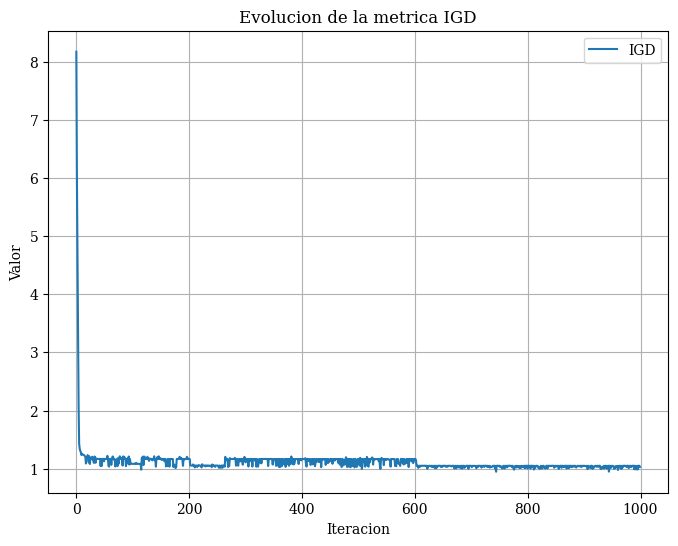

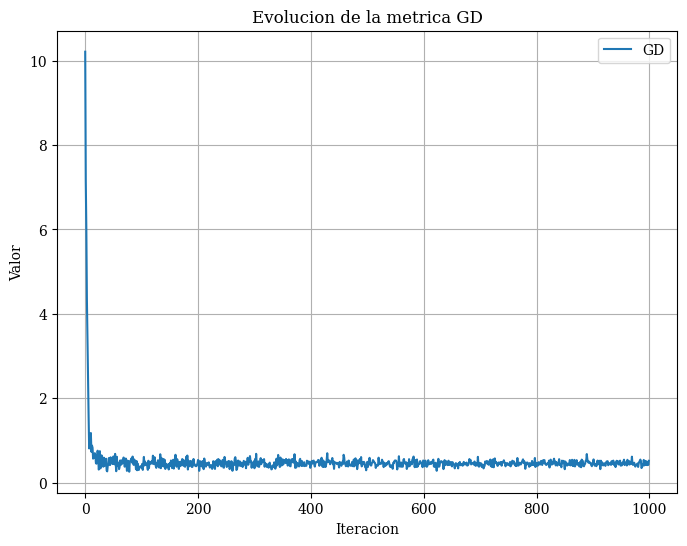

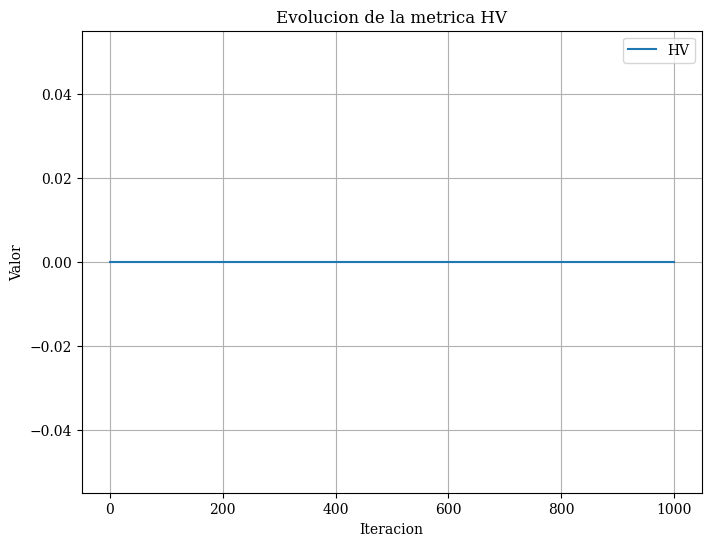

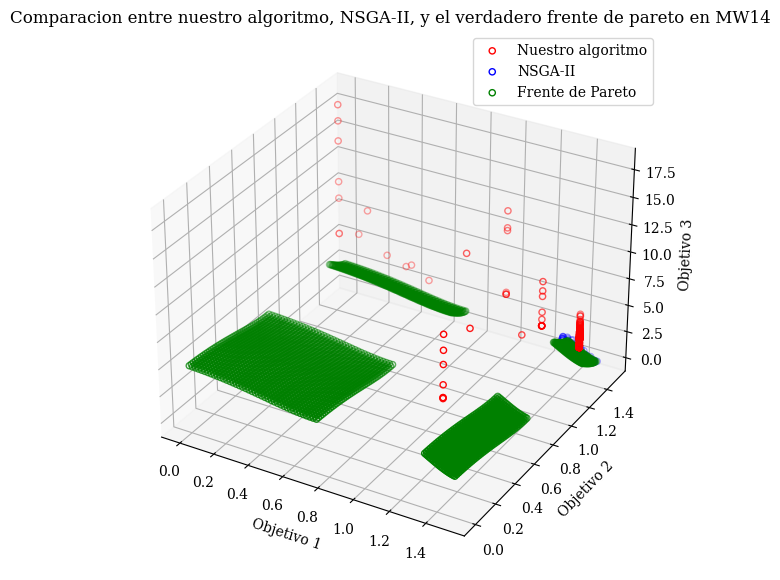

In [ ]:
# Ejecutar NSGA-II usando pymoo
algorithm = NSGA2(pop_size=100)
print("Ejecutando NSGA-II...")
res = minimize(problem, algorithm, termination=('n_gen', 100), verbose=False)

# Ejecutar tu algoritmo con métricas
print("Ejecutando tu algoritmo...")
best_pop,metrics = run_your_algorithm(ngen=1000,fit = fit, pmut = 1/30, L = 5, pcross = 0.7, N = 100, T = 100, elitism = True, verbose=True)
your_algo_front = np.array([fit(ind) for ind in best_pop])

# Visualizar la evolucion de las metricas
plot_metrics(metrics)

# Visualizar los frentes de Pareto de ambos algoritmos y el frente verdadero

fig = plt.figure(figsize=(10, 7))
ax = plt.axes(projection="3d")  # Directly create 3D axes via plt

ax.scatter(your_algo_front[:, 0], your_algo_front[:, 1],your_algo_front[:, 2], label="Nuestro algoritmo", color='r', marker='o', edgecolor='r', facecolor='none')
ax.scatter(res.F[:, 0], res.F[:, 1],res.F[:, 2], label="NSGA-II", color='b', marker='o', edgecolor='b', facecolor='none')
ax.scatter(problem.pareto_front()[:, 0], problem.pareto_front()[:, 1],problem.pareto_front()[:, 2], label="Frente de Pareto", color='g', marker='o', edgecolor='g', facecolor='none')
ax.set_xlabel("Objetivo 1")
ax.set_ylabel("Objetivo 2")
ax.set_zlabel("Objetivo 3")
plt.legend()
plt.title("Comparacion entre nuestro algoritmo, NSGA-II, y el verdadero frente de pareto en MW14")
plt.show()

### Usando MOEA/D ###

In [ ]:
import numpy as np

# Definir el problema MW14 usando pymoo
problem = get_problem("mw14", n_var=30)
solution_range = [0,1.5]

# Problem Definition
def evaluate_objectives_contraints(population):
    eva = problem.evaluate(population)
    objectives = eva[0]
    constraint = eva[1]
    return objectives,constraint

def evaluate_objectives(population):
    objectives = problem.evaluate(population)[0]
    return objectives


def mutate (ind, bounds, pmut, L=1): # devuelve individuo mutado, pudiendo incrementar en 1 el valor de uno de los parametros segun una distribucion normal
    for _ in range(L):
        if np.random.rand() < pmut:
            for i in range(len(ind)):  
                #ind[i] += np.random.uniform(-0.1,0.1)         
                ind[i] += np.random.normal(0,0.1)
                #ind[i] += np.random.normal(0,0.5)
                
    clipped_ind = np.clip(ind, bounds[0], bounds[1])
    return clipped_ind

def blx_alpha_crossover(parent1, parent2, pcross, alpha, lower_bound, upper_bound):
    """
    BLX-alpha crossover implementation.
    
    Parameters:
        parent1 (array-like): First parent solution.
        parent2 (array-like): Second parent solution.
        alpha (float): BLX-alpha parameter.
        lower_bound (array-like): Lower bounds for variables.
        upper_bound (array-like): Upper bounds for variables.
    
    Returns:
        child1, child2 (array-like): Two offspring solutions.
    """
    if np.random.rand() < pcross:
        # Compute the range
        d = np.abs(parent2 - parent1)
        lower = np.minimum(parent1, parent2) - alpha * d
        upper = np.maximum(parent1, parent2) + alpha * d
        
        # Clip to the bounds
        lower = np.maximum(lower, lower_bound)
        upper = np.minimum(upper, upper_bound)
        
        # Generate children within the range
        child1 = np.random.uniform(lower, upper)
        child2 = np.random.uniform(lower, upper)

        return child1.copy(), child2.copy()
    
    else:
        return parent1.copy(), parent2.copy()


# Tchebycheff Decomposition
def tchebycheff_function(solution, weights, ideal_point):
    return np.max(weights * np.abs(solution - ideal_point))


# Population Initialization
def create_population(solution_range = [0,1.5], individual_variables = 30, N=100):
    pop = np.empty([N, individual_variables])
    for i in range(N):
        ind = [random.uniform(solution_range[0],solution_range[1]) for _ in range(individual_variables)]
        pop[i] = ind
    return pop


def initialize_weights(pop_size, n_objs):
    """
    Generate weight vectors for decomposition.
    """
    weights = np.random.dirichlet(np.ones(n_objs), size=pop_size) # Genera una matriz de pop x 3 donde la suma de cada fila es 1 y son randoms?
    return weights


# Update Neighboring Solutions
def update_neighbors(population, obj_values, ideal_point, weights, neighbors, new_solution, new_obj_value):
    """
    Update the solutions in the neighborhood based on the Tchebycheff approach.
    """
    for i in neighbors:
        # Evaluate the Tchebycheff function for the current and new solutions
        current_tchebycheff = tchebycheff_function(obj_values[i], weights[i], ideal_point)
        new_tchebycheff = tchebycheff_function(new_obj_value, weights[i], ideal_point)
        # Replace the solution if the new one is better
        if new_tchebycheff < current_tchebycheff:
            population[i] = new_solution
            obj_values[i] = new_obj_value


# Main MOEA/D Algorithm
def moead(n_vars = 30, n_objs = 3, bounds = [0,1.5], pop_size = 100, generations = 1000, neighborhood_size = 10, pcross = 0.7, crossalpha = 0.5, pmut = 1.0/30, num_max_mut = 20, verbose = True):
    """
    Main MOEA/D function.
    """

    # Initialize metrics
    metrics = {"IGD": [], "GD": [], "HV": []}

    # Inicialización de métricas
    igd_metric = IGD(problem.pareto_front())
    gd_metric = GD(problem.pareto_front())
    hv_metric = HV(ref_point=np.array([1.5, 1.5, 5]))  

    # Step 1: Initialization
    population = create_population([0,1.5], n_vars, pop_size)
    obj_values = evaluate_objectives(population)
    weights = initialize_weights(pop_size, n_objs)

    neighbors = []
    for w in weights:
        closest_neighbors = np.argsort(np.linalg.norm(weights - w, axis=1))[:neighborhood_size]
        neighbors.append(closest_neighbors)
    neighbors = [np.argsort(np.linalg.norm(weights - w, axis=1))[:neighborhood_size] for w in weights]
    
    ideal_point = np.min(obj_values, axis=0)

    # Step 2: Evolutionary Loop
    for generation in range(generations):
        for i in range(pop_size):

            # Selection select two random parents from the neighborhood
            parent_indices = np.random.choice(neighbors[i], 2, replace=False)
            parent1, parent2 = population[parent_indices[0]], population[parent_indices[1]]
            
            # Crossover
            child1, child2 = blx_alpha_crossover(parent1, parent2, pcross, crossalpha, bounds[0], bounds[1])
            
            # Mutation
            child1 = mutate(child1, bounds, pmut, num_max_mut)
            child2 = mutate(child2, bounds, pmut, num_max_mut)
            
            # Evaluate objectives
            new_obj_value1,new_contraint_value1 = evaluate_objectives_contraints(child1)
            new_obj_value2,new_contraint_value2 = evaluate_objectives_contraints(child2)
            if new_contraint_value1>=0:
                # Update the ideal point
                ideal_point = np.minimum(ideal_point, new_obj_value1)
                # Update the neighborhood
                update_neighbors(population, obj_values, ideal_point, weights, neighbors[i], child1, new_obj_value1)

            if new_contraint_value2>=0:
                # Update the ideal point
                ideal_point = np.minimum(ideal_point, new_obj_value2)
                # Update the neighborhood
                update_neighbors(population, obj_values, ideal_point, weights, neighbors[i], child2, new_obj_value2)
            

        # Mostrar métricas cada generación
        # Calcular métricas
        pop_fitness = evaluate_objectives(population)  # Asegurarse de que sea un np.array 2D
        igd_value = igd_metric(pop_fitness)
        gd_value = gd_metric(pop_fitness)
        hv_value = hv_metric(pop_fitness)

        metrics["IGD"].append(igd_value)
        metrics["GD"].append(gd_value)
        metrics["HV"].append(hv_value)

        
        if verbose:
            print(f"{generation+1:6} | {len(population) * (generation+1):8} | {len(population)} | {igd_value:.10f} | {gd_value:.10f} | {hv_value:.10e}")

    return population, metrics


In [ ]:
def evolve_with_stadistics(n_vars, n_objs, bounds, pop_size, generations, neighborhood_size, pcross, crossalpha, pmut, num_max_mut, verbose = False, iterations = 10):
    bestGD = 999999999999999
    bestPareto = []
    bestParetoIndex = 0
    all_experiment_metrics = []
    best_experiments_metrics = {"IGD": [], "GD": [], "HV": []}
    for i in range(iterations):
        best_pop, metrics = moead(n_vars, n_objs, bounds, pop_size, generations, neighborhood_size, pcross, crossalpha, pmut, num_max_mut, verbose = verbose)

        all_experiment_metrics.append(metrics)
        for metric,value in metrics.items():
            best_experiments_metrics[metric].append(value[-1])

        if metrics['GD'][-1]<bestGD:
            bestGD = metrics['GD'][-1]
            bestPareto = best_pop
            bestParetoIndex = i
        
    return bestPareto,bestParetoIndex, all_experiment_metrics,best_experiments_metrics

In [ ]:
# Parameters
n_vars = 30
n_objs = 3
bounds = (np.zeros(n_vars), np.ones(n_vars)*1.5)
pop_size = 100
generations = 1000
neighborhood_size = 10

pcross = 0.7
crossalpha = 0.7  # Exploration parameter
pmut = 1.0/30
num_max_mut = 5

iterations = 10

bestPop,bestPopIndex, all_experiment_metrics,best_experiments_metrics = evolve_with_stadistics(n_vars, n_objs, bounds, pop_size, generations, neighborhood_size, pcross, crossalpha, pmut, num_max_mut, verbose = False, iterations = iterations)

Mejores valores del mejor experimento: GD: 0.09423100791817031 IGD: 0.2184126892932947 HV: 3.214474433787676


<Figure size 800x400 with 0 Axes>

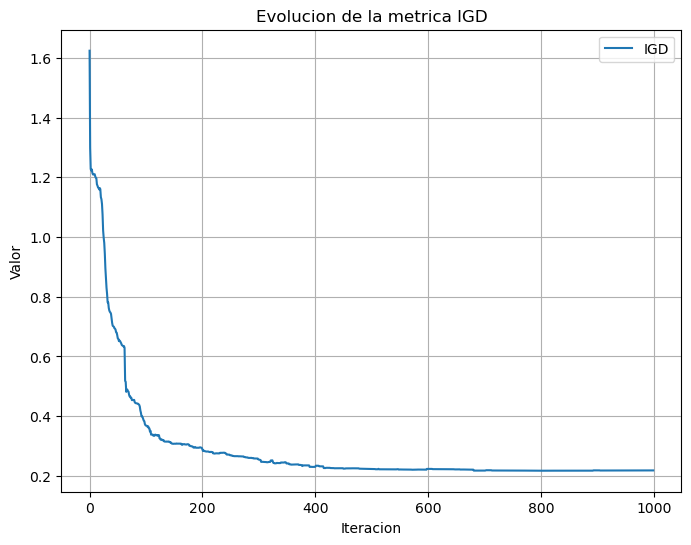

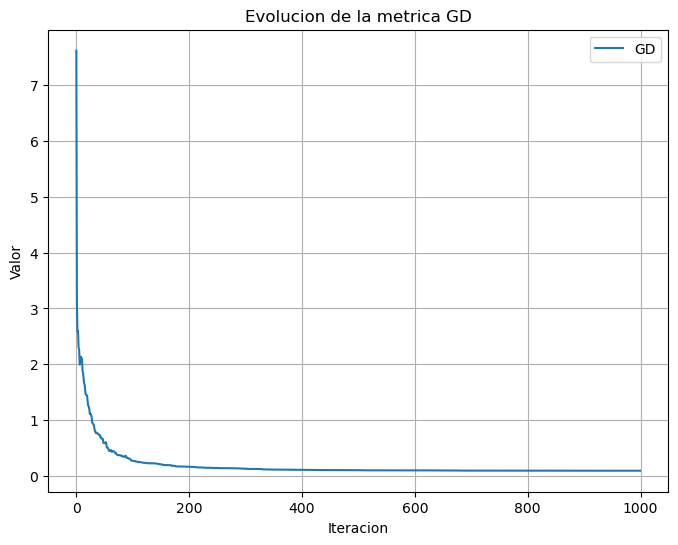

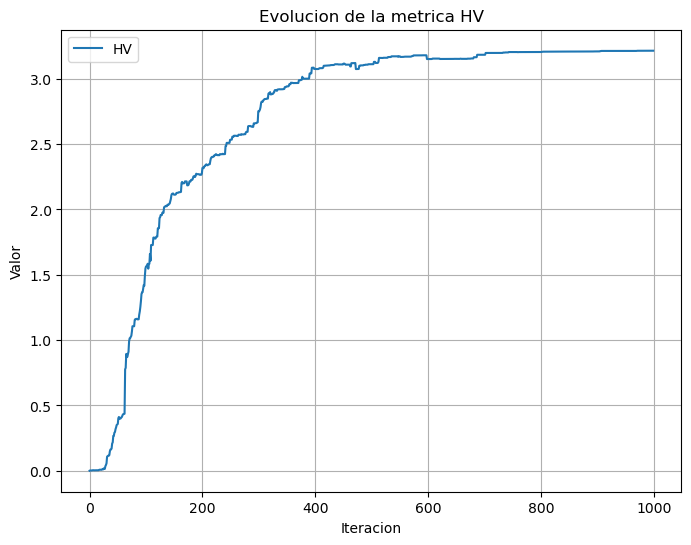

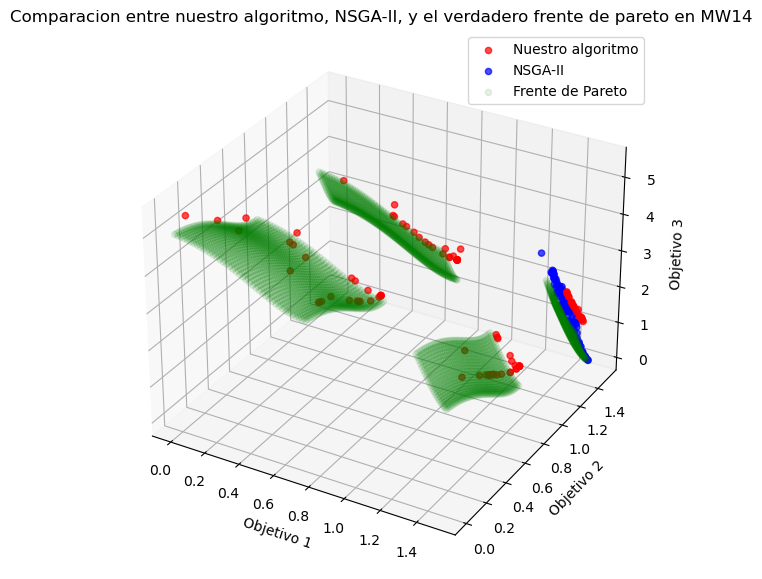

In [ ]:
# Ploteamos el mejor intento
print(F"Mejores valores del mejor experimento: GD: {best_experiments_metrics['GD'][bestPopIndex]} IGD: {best_experiments_metrics['IGD'][bestPopIndex]} HV: {best_experiments_metrics['HV'][bestPopIndex]}")
plot_metrics(all_experiment_metrics[bestPopIndex])
fig = plt.figure(figsize=(10, 7))
ax = plt.axes(projection="3d")  # Directly create 3D axes via plt

best_obj_values = evaluate_objectives(bestPop)
ax.scatter(best_obj_values[:, 0], best_obj_values[:, 1],best_obj_values[:, 2], label="Nuestro algoritmo", color='r', marker='o', edgecolor='r',alpha = 0.7)
ax.scatter(res.F[:, 0], res.F[:, 1],res.F[:, 2], label="NSGA-II", color='b', marker='o', edgecolor='b',alpha = 0.7)
ax.scatter(problem.pareto_front()[:, 0], problem.pareto_front()[:, 1],problem.pareto_front()[:, 2], label="Frente de Pareto", color='g', marker='o', edgecolor='g',alpha = 0.1)
ax.set_xlabel("Objetivo 1")
ax.set_ylabel("Objetivo 2")
ax.set_zlabel("Objetivo 3")
plt.legend()
plt.title("Comparacion entre nuestro algoritmo, NSGA-II, y el verdadero frente de pareto en MW14")
plt.show()

In [ ]:
stadistics={'min':min(best_experiments_metrics['GD']), 'max':max(best_experiments_metrics['GD']), 'mean':np.mean(best_experiments_metrics['GD']),'median':np.median(best_experiments_metrics['GD']),'CI':np.percentile(best_experiments_metrics['GD'], [2.5, 97.5]),'std':np.std(best_experiments_metrics['GD'])} 
print(f"metricas para el GD: {stadistics}")

stadistics={'min':min(best_experiments_metrics['IGD']), 'max':max(best_experiments_metrics['IGD']), 'mean':np.mean(best_experiments_metrics['IGD']),'median':np.median(best_experiments_metrics['IGD']),'CI':np.percentile(best_experiments_metrics['IGD'], [2.5, 97.5]),'std':np.std(best_experiments_metrics['IGD'])} 
print(f"metricas para el IGD: {stadistics}")

stadistics={'min':min(best_experiments_metrics['HV']), 'max':max(best_experiments_metrics['HV']), 'mean':np.mean(best_experiments_metrics['HV']),'median':np.median(best_experiments_metrics['HV']),'CI':np.percentile(best_experiments_metrics['HV'], [2.5, 97.5]),'std':np.std(best_experiments_metrics['HV'])} 
print(f"metricas para el HV: {stadistics}")

metricas para el GD: {'min': 0.09423100791817031, 'max': 0.2299230472743328, 'mean': 0.14570920967264586, 'median': 0.1441742717917638, 'CI': array([0.09876572, 0.21901372]), 'std': 0.037068215083861294}
metricas para el IGD: {'min': 0.21639403356031056, 'max': 0.3218195260030307, 'mean': 0.24835452600258073, 'median': 0.24439201326719162, 'CI': array([0.21684823, 0.3091407 ]), 'std': 0.02975617144614314}
metricas para el HV: {'min': 1.9832979111397442, 'max': 3.214474433787676, 'mean': 2.7411100723756414, 'median': 2.8065962079122677, 'CI': array([2.09754181, 3.20959135]), 'std': 0.34625003462031045}


In [ ]:
def plot_multiple_metrics(metrics):
    colors = plt.cm.tab10(np.linspace(0, 1, len(metrics)))  # Using a colormap
    # Create a plot for each metric
    for metric_name, _ in metrics[0].items():
        plt.figure(figsize=(8, 6))
        for i,met in enumerate(metrics):
            plt.plot(met[metric_name], label=f"{metric_name}_{i}",color = colors[i])
            plt.plot.hlines(nsga2_metrics[metric_name], xmin=0, xmax=max(generations), label="NSGA-II", color="red", linestyle="--")
            plt.xlabel("Iteracion")
            plt.ylabel("Valor")
            plt.title(f"Evolucion de la metrica {metric_name}")
            plt.legend()
            plt.grid(True)
        plt.show()

In [ ]:
print(f"El mejor valor es {bestPopIndex}")
plot_multiple_metrics(all_experiment_metrics)

---
## TSP MO

In [ ]:
class TSPProblem(Problem):
    def __init__(self, n_cities, seed=50):
        # Define the number of variables (cities) and objectives (time and distance)
        super().__init__(n_var=n_cities, n_obj=2, n_constr=0, xl=0, xu=1)
        
        # Initialize the random seed for reproducibility
        if seed is not None:
            np.random.seed(seed)
        
        # Generate random distances and times between cities
        self.distances = np.random.uniform(0, 100, size=(n_cities, n_cities))
        self.distances = (self.distances + self.distances.T) / 2
        self.times = np.random.uniform(0, 300, size=(n_cities, n_cities))
        random.seed(None)
        
        # Ensure the diagonal is zero (distance/time from a city to itself is zero)
        np.fill_diagonal(self.distances, 0)
        np.fill_diagonal(self.times, 0)

    def _evaluate(self, x, out, *args, **kwargs):
        # Calculate the total distance and time for each solution in x
        distances = []
        times = []
        
        for route in x:
            perm = np.argsort(route)
            total_distance = 0
            total_time = 0
            
            for i in range(len(perm) - 1):
                total_distance += self.distances[perm[i], perm[i+1]]
                total_time += self.times[perm[i], perm[i+1]]
            
            # Add distance and time from last city back to the first city
            total_distance += self.distances[perm[-1], perm[0]]
            total_time += self.times[perm[-1], perm[0]]
            
            distances.append(total_distance)
            times.append(total_time)
        
        out["F"] = np.column_stack([distances, times])

Comprobación del funcionamiento del algoritmo NSGA2 para las funciones continuas

In [ ]:
problem = get_problem("mw14", n_var = 30)
print(problem.n_var)
print(problem.n_obj)
print(problem.xl)
print(problem.xu)

30
3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
[1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5
 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5 1.5]


Comprobación del funcionamiento del algoritmo NSGA2 para el TSPMO

In [ ]:
problem = TSPProblem(100)
print(np.shape(problem.distances))
print(np.shape(problem.times))

(100, 100)
(100, 100)


In [ ]:
algorithm = NSGA2(pop_size=100)
res = minimize(problem,
               algorithm,
               ('n_gen', 10),
               verbose=False)
res2 = minimize(problem,
               algorithm,
               ('n_gen', 100),
               verbose=False)
res3 = minimize(problem,
               algorithm,
               ('n_gen', 10000),
               verbose=False)


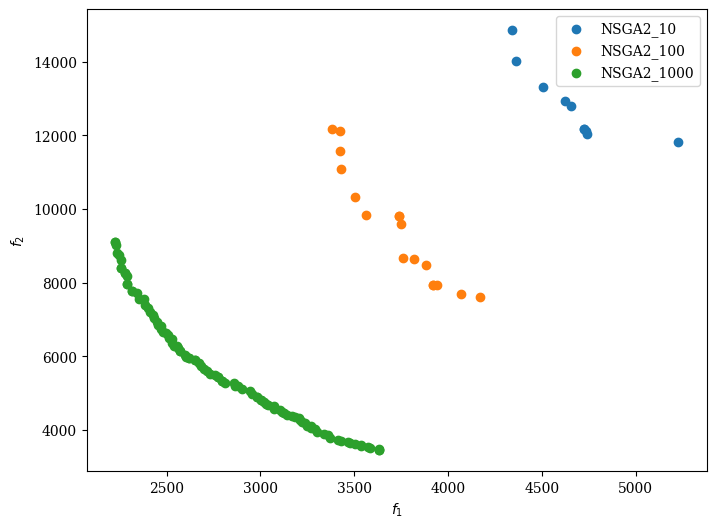

In [ ]:
scatter = Scatter()
scatter.add(res.F, label="NSGA2_10")
scatter.add(res2.F, label="NSGA2_100")
scatter.add(res3.F, label="NSGA2_1000")

scatter.legend=True
scatter.show()


In [ ]:
# Definición de la clase TSPProblem
class TSPProblem:
    def __init__(self, n_cities, distances, times):
        self.n_cities = n_cities
        self.distances = distances
        self.times = times

    # Función de evaluación para TSP
    def evaluate(self, route):
        total_distance = 0
        total_time = 0
        for i in range(len(route) - 1):
            total_distance += self.distances[route[i], route[i+1]]
            total_time += self.times[route[i], route[i+1]]
        
        # Añadir la distancia y el tiempo de vuelta a la ciudad inicial
        total_distance += self.distances[route[-1], route[0]]
        total_time += self.times[route[-1], route[0]]
        
        return [total_distance, total_time]

# Crear población con permutaciones de ciudades
def create_population(n_cities, N=100):
    pop = []
    for _ in range(N):
        ind = list(range(n_cities))
        random.shuffle(ind)
        pop.append(ind)
    return pop

# Función de ordenación por fitness
def sort_population(pop, tsp_problem):
    fitness = [tsp_problem.evaluate(ind) for ind in pop]
    pareto_front = pareto_rank(fitness)
    sorted_pop = [pop[i] for i in pareto_front]
    sorted_fitness = [fitness[i] for i in pareto_front]
    return sorted_pop, sorted_fitness

def pareto_rank(fitness):
    ranked = []
    for i in range(len(fitness)):
        rank = 0
        for j in range(len(fitness)):
            if i != j and dominates(fitness[j], fitness[i]):
                rank += 1
        ranked.append((i, rank))
    ranked.sort(key=lambda x: x[1])
    return [i[0] for i in ranked]

def dominates(f1, f2):
    return all(f1[i] <= f2[i] for i in range(len(f1))) and any(f1[i] < f2[i] for i in range(len(f1)))

# Función de selección por torneo
def select(pop, T):
    selected = random.sample(pop, T)
    selected_fitness = [tsp_problem.evaluate(ind) for ind in selected]
    return selected[selected_fitness.index(min(selected_fitness))]

# Función de cruce (crossover)
def crossover(ind1, ind2, pcross=0.7):
    if random.random() < pcross:
        crossover_point = random.randint(1, len(ind1) - 1)
        child1 = ind1[:crossover_point] + [i for i in ind2 if i not in ind1[:crossover_point]]
        child2 = ind2[:crossover_point] + [i for i in ind1 if i not in ind2[:crossover_point]]
        return child1, child2
    else:
        return ind1, ind2

# # Función de mutación
def mutate(ind, pmut=0.1):
    if random.random() < pmut:
        i, j = random.sample(range(len(ind)), 2)
        ind[i], ind[j] = ind[j], ind[i]
    return ind

# Función de evolución del algoritmo
def evolve(pop, tsp_problem, pmut, ngen=100, T=2, elitism=False, verbose=False):
    pop, fitness = sort_population(pop, tsp_problem)
    best = pop[0]
    
    # Inicialización de métricas
    # igd_metric = IGD(problem.pareto_front())
    # gd_metric = GD(problem.pareto_front())
    # hv_metric = HV(ref_point=np.array([1.0, 1.0]))  # El punto de referencia para HV debe ser (1.0, 1.0) para ZDT1

    for gen in range(ngen):
        newpop = []
        if elitism:
            newpop.append(best)
        while len(newpop) < len(pop):
            ind1 = select(pop, T)
            ind2 = select(pop, T)
            child1, child2 = crossover(ind1, ind2, pcross=0.7)
            child1 = mutate(child1, pmut)
            child2 = mutate(child2, pmut)
            newpop.append(child1)
            newpop.append(child2)
        pop = newpop
        pop, fitness = sort_population(pop, tsp_problem)
        best = pop[0]
                # Calcular métricas
        pop_fitness = np.array([fit(ind) for ind in pop])  # Asegurarse de que sea un np.array 2D
        # igd_value = igd_metric(pop_fitness)
        # gd_value = gd_metric(pop_fitness)
        # hv_value = hv_metric(pop_fitness)

        if verbose:
            # print(f"{gen+1:6} | {len(pop) * (gen+1):8} | {len(pop)} | {igd_value:.10f} | {gd_value:.10f} | {hv_value:.10e}")
            print(f"{gen+1:6} | {len(pop)} | Best distance: {fitness[0][0]:.4f} | Best time: {fitness[0][1]:.4f}")



    return pop

# Ejecutar el algoritmo
def run_tsp_algorithm(tsp_problem, ngen=1000, verbose=False):
    N = 100  # Población de 100 individuos
    pop = create_population(tsp_problem.n_cities, N)
    pmut = 0.1
    best = evolve(pop, tsp_problem, pmut, ngen=ngen, T=2, elitism=True, verbose=verbose)
    return np.array([tsp_problem.evaluate(ind) for ind in best])

# Ejemplo de uso:
n_cities = 100
distances = np.random.uniform(0, 100, size=(n_cities, n_cities))
distances = (distances + distances.T) / 2
times = np.random.uniform(0, 300, size=(n_cities, n_cities))
np.fill_diagonal(distances, 0)
np.fill_diagonal(times, 0)

tsp_problem = TSPProblem(n_cities, distances, times)

# Ejecutar el algoritmo
your_algo_front = run_tsp_algorithm(tsp_problem, ngen=1000, verbose=True)



     1 | 101 | Best distance: 4429.4984 | Best time: 13767.7173
     2 | 101 | Best distance: 4429.4984 | Best time: 13767.7173
     3 | 101 | Best distance: 4429.4984 | Best time: 13767.7173
     4 | 101 | Best distance: 4429.4984 | Best time: 13767.7173
     5 | 101 | Best distance: 4429.4984 | Best time: 13767.7173
     6 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
     7 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
     8 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
     9 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
    10 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
    11 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
    12 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
    13 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
    14 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
    15 | 101 | Best distance: 4617.1008 | Best time: 12144.6332
    16 | 101 | Best distance: 4617.1008 

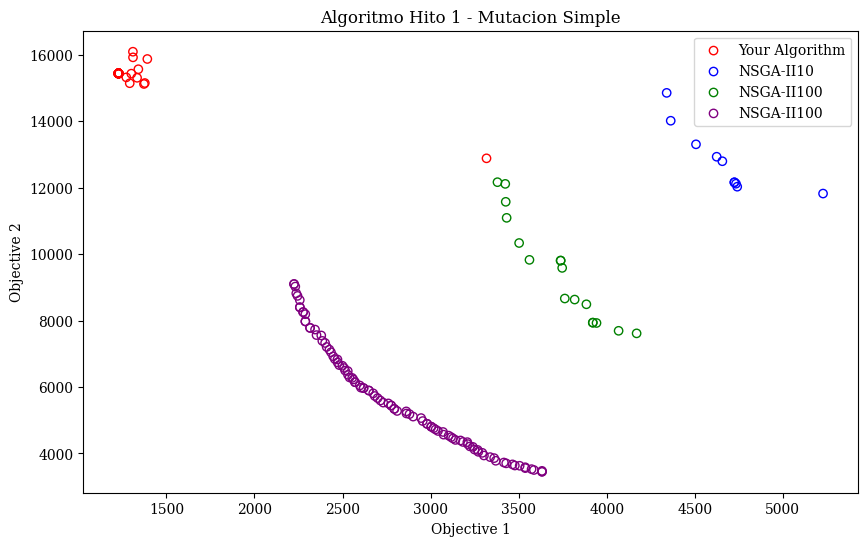

In [ ]:
# Visualizar los resultados
plt.figure(figsize=(10, 6))

# Resultado de tu algoritmo
plt.scatter(your_algo_front[:, 0], your_algo_front[:, 1], label="Your Algorithm", color='r', marker='o', edgecolor='r', facecolor='none')

# Resultado de NSGA-II
plt.scatter(res.F[:, 0], res.F[:, 1], label="NSGA-II10", color='b', marker='o', edgecolor='b', facecolor='none')
plt.scatter(res2.F[:, 0], res2.F[:, 1], label="NSGA-II100", color='g', marker='o', edgecolor='g', facecolor='none')
plt.scatter(res3.F[:, 0], res3.F[:, 1], label="NSGA-II100", color='g', marker='o', edgecolor='purple', facecolor='none')

# Mejor frente de Pareto (si se tiene)
# Suponiendo que "pareto_front" es una función que devuelve el frente de Pareto óptimo
# En este caso, deberíamos tenerlo como un conjunto de puntos ideales
# plt.scatter(problem.pareto_front()[:, 0], problem.pareto_front()[:, 1], label="True Pareto Front", color='g', marker='o', edgecolor='g', facecolor='none')

# Etiquetas y leyenda
plt.xlabel("Objective 1")
plt.ylabel("Objective 2")
plt.legend()
plt.title("Algoritmo Hito 1 - Mutacion Simple")

plt.show()

In [ ]:
def mutate_swap (ind, pmut): # la mutación consistirá en intercambiar elementos
    if random.random() < pmut:
        size = len(ind)
        pos1 = random.randint(0, size - 1)
        pos2 = random.randint(0, size - 1)
        ind[pos1], ind[pos2] = ind[pos2], ind[pos1]
    return ind

def mutate_insert (ind, pmut): # la mutación consistirá en borrar un elemento e insertarlo en otro lado
    if random.random() < pmut:
        size = len(ind)
        pos1 = random.randint(0, size - 1)
        pos2 = random.randint(0, size - 1)
        elem = ind.pop(pos1)
        ind.insert(pos2, elem)
    return ind

def mutate_reverse (ind, pmut): # selecciona dos puntos e invierte la secuencia entre ellos
    if random.random() < pmut:
        size = len(ind)
        pos1 = random.randint(0, size - 1)
        pos2 = random.randint(0, size - 1)
        if pos1 > pos2:
            pos1, pos2 = pos2, pos1
        ind[pos1:pos2] = reversed(ind[pos1:pos2])
    return ind

mutations = [mutate_swap, mutate_insert, mutate_reverse]
def mutate_2 (ind, pmut, L=1):
    operator = random.choice(mutations)
    return operator(ind, pmut)

In [ ]:

# Función de evolución del algoritmo
def evolve(pop, tsp_problem, pmut, ngen=100, T=2, elitism=False, verbose=False):
    pop, fitness = sort_population(pop, tsp_problem)
    best = pop[0]
    
    # Inicialización de métricas
    # igd_metric = IGD(problem.pareto_front())
    # gd_metric = GD(problem.pareto_front())
    # hv_metric = HV(ref_point=np.array([1.0, 1.0]))  # El punto de referencia para HV debe ser (1.0, 1.0) para ZDT1

    for gen in range(ngen):
        newpop = []
        if elitism:
            newpop.append(best)
        while len(newpop) < len(pop):
            ind1 = select(pop, T)
            ind2 = select(pop, T)
            child1, child2 = crossover(ind1, ind2, pcross=0.7)
            child1 = mutate_2(child1, pmut)
            child2 = mutate_2(child2, pmut)
            newpop.append(child1)
            newpop.append(child2)
        pop = newpop
        pop, fitness = sort_population(pop, tsp_problem)
        best = pop[0]
                # Calcular métricas
        pop_fitness = np.array([fit(ind) for ind in pop])  # Asegurarse de que sea un np.array 2D
        # igd_value = igd_metric(pop_fitness)
        # gd_value = gd_metric(pop_fitness)
        # hv_value = hv_metric(pop_fitness)

        if verbose:
            # print(f"{gen+1:6} | {len(pop) * (gen+1):8} | {len(pop)} | {igd_value:.10f} | {gd_value:.10f} | {hv_value:.10e}")
            print(f"{gen+1:6} | {len(pop)} | Best distance: {fitness[0][0]:.4f} | Best time: {fitness[0][1]:.4f}")



    return pop

# Ejecutar el algoritmo
def run_tsp_algorithm(tsp_problem, ngen=1000, verbose=False):
    N = 100  # Población de 100 individuos
    pop = create_population(tsp_problem.n_cities, N)
    pmut = 0.1
    best = evolve(pop, tsp_problem, pmut, ngen=ngen, T=2, elitism=True, verbose=verbose)
    return np.array([tsp_problem.evaluate(ind) for ind in best])

# Ejemplo de uso:
n_cities = 100
distances = np.random.uniform(0, 100, size=(n_cities, n_cities))
distances = (distances + distances.T) / 2
times = np.random.uniform(0, 300, size=(n_cities, n_cities))
np.fill_diagonal(distances, 0)
np.fill_diagonal(times, 0)

tsp_problem = TSPProblem(n_cities, distances, times)

# Ejecutar el algoritmo
your_algo_front = run_tsp_algorithm(tsp_problem, ngen=50_000, verbose=True)



     1 | 101 | Best distance: 4483.4077 | Best time: 14138.2695
     2 | 101 | Best distance: 4483.4077 | Best time: 14138.2695
     3 | 101 | Best distance: 4237.0274 | Best time: 14252.6549
     4 | 101 | Best distance: 4237.0274 | Best time: 14252.6549
     5 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
     6 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
     7 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
     8 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
     9 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
    10 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
    11 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
    12 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
    13 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
    14 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
    15 | 101 | Best distance: 5038.8077 | Best time: 11726.8103
    16 | 101 | Best distance: 5038.8077 

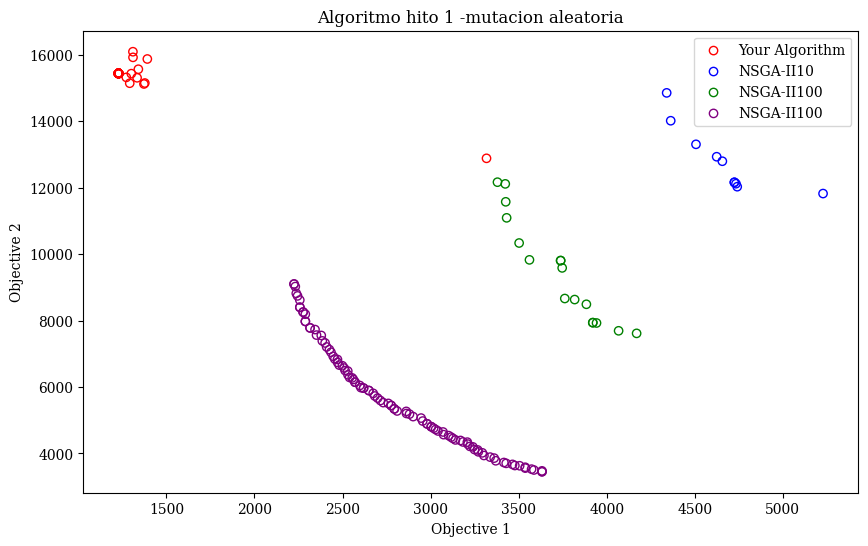

In [ ]:
# Visualizar los resultados
plt.figure(figsize=(10, 6))

# Resultado de tu algoritmo
plt.scatter(your_algo_front[:, 0], your_algo_front[:, 1], label="Your Algorithm", color='r', marker='o', edgecolor='r', facecolor='none')

# Resultado de NSGA-II
plt.scatter(res.F[:, 0], res.F[:, 1], label="NSGA-II10", color='b', marker='o', edgecolor='b', facecolor='none')
plt.scatter(res2.F[:, 0], res2.F[:, 1], label="NSGA-II100", color='g', marker='o', edgecolor='g', facecolor='none')
plt.scatter(res3.F[:, 0], res3.F[:, 1], label="NSGA-II100", color='g', marker='o', edgecolor='purple', facecolor='none')

# Mejor frente de Pareto (si se tiene)
# Suponiendo que "pareto_front" es una función que devuelve el frente de Pareto óptimo
# En este caso, deberíamos tenerlo como un conjunto de puntos ideales
# plt.scatter(problem.pareto_front()[:, 0], problem.pareto_front()[:, 1], label="True Pareto Front", color='g', marker='o', edgecolor='g', facecolor='none')

# Etiquetas y leyenda
plt.xlabel("Objective 1")
plt.ylabel("Objective 2")
plt.legend()
plt.title("Algoritmo hito 1 -mutacion aleatoria")
plt.show()


### 100 gen MOAD

Generation 1/100: Ideal Point = [ 4393.14285217 12152.74865642]
Generation 2/100: Ideal Point = [ 4393.14285217 11282.66494897]
Generation 3/100: Ideal Point = [ 4346.86111838 11181.46968108]
Generation 4/100: Ideal Point = [ 4292.47340889 10608.03912309]
Generation 5/100: Ideal Point = [4280.17319679 9925.07472358]
Generation 6/100: Ideal Point = [4280.17319679 9809.93273387]
Generation 7/100: Ideal Point = [4217.38548377 9299.99904902]
Generation 8/100: Ideal Point = [4217.38548377 8457.19717538]
Generation 9/100: Ideal Point = [4179.30489765 8457.19717538]
Generation 10/100: Ideal Point = [4173.15710454 8269.35670192]
Generation 11/100: Ideal Point = [4173.15710454 8226.63987345]
Generation 12/100: Ideal Point = [4173.15710454 8226.63987345]
Generation 13/100: Ideal Point = [4149.71361619 7995.74816993]
Generation 14/100: Ideal Point = [4149.71361619 7515.87642206]
Generation 15/100: Ideal Point = [4149.71361619 7345.61408579]
Generation 16/100: Ideal Point = [4149.71361619 7256.497

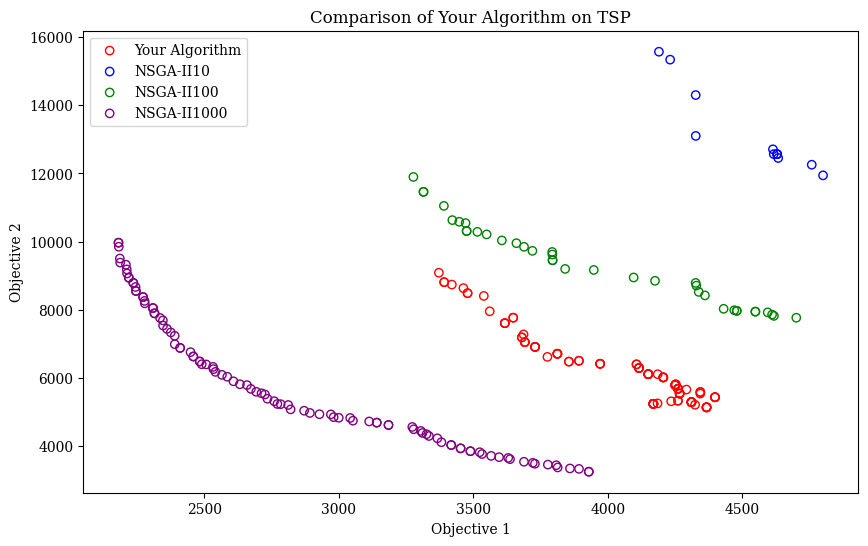

Generation 1/100: Ideal Point = [ 4542.65313841 12622.50012677]
Generation 2/100: Ideal Point = [ 4375.51795912 11889.16345068]
Generation 3/100: Ideal Point = [ 4303.0630348  10980.89014649]
Generation 4/100: Ideal Point = [ 4248.6687263  10589.16029855]
Generation 5/100: Ideal Point = [4246.25379279 9703.87101641]
Generation 6/100: Ideal Point = [4090.66924908 9054.79534773]
Generation 7/100: Ideal Point = [4090.66924908 8670.56653223]
Generation 8/100: Ideal Point = [4046.06671994 8589.05170341]
Generation 9/100: Ideal Point = [4046.06671994 8549.63059051]
Generation 10/100: Ideal Point = [4046.06671994 8452.19520631]
Generation 11/100: Ideal Point = [4046.06671994 8276.02083184]
Generation 12/100: Ideal Point = [4008.7071752  8276.02083184]
Generation 13/100: Ideal Point = [4008.7071752  8253.49017272]
Generation 14/100: Ideal Point = [3953.17293391 8253.49017272]
Generation 15/100: Ideal Point = [3953.17293391 8234.50127812]
Generation 16/100: Ideal Point = [3953.17293391 8062.361

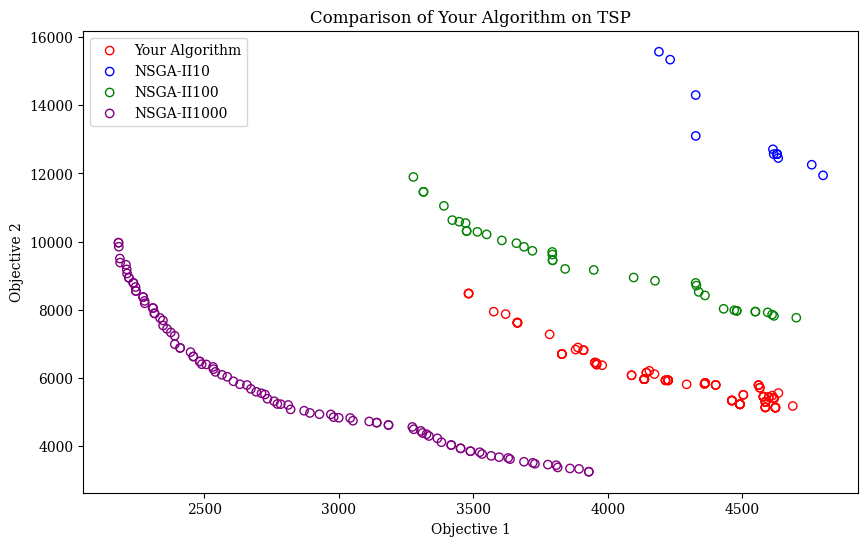

Generation 1/100: Ideal Point = [ 4571.39798584 12238.06101909]
Generation 2/100: Ideal Point = [ 4571.39798584 11742.37883635]
Generation 3/100: Ideal Point = [ 4474.09961834 10883.79669299]
Generation 4/100: Ideal Point = [ 4474.09961834 10473.30081151]
Generation 5/100: Ideal Point = [ 4455.49618336 10150.80920821]
Generation 6/100: Ideal Point = [4441.88149745 9937.75514288]
Generation 7/100: Ideal Point = [4441.88149745 9260.04297796]
Generation 8/100: Ideal Point = [4377.38871594 9260.04297796]
Generation 9/100: Ideal Point = [4377.38871594 9203.49950402]
Generation 10/100: Ideal Point = [4299.18736461 8880.5237391 ]
Generation 11/100: Ideal Point = [4244.98674736 8767.63055575]
Generation 12/100: Ideal Point = [4196.8090586 8686.1321734]
Generation 13/100: Ideal Point = [4196.8090586  8401.24665896]
Generation 14/100: Ideal Point = [4196.8090586  8156.78133429]
Generation 15/100: Ideal Point = [4155.8244325  8156.78133429]
Generation 16/100: Ideal Point = [4053.25507757 7772.562

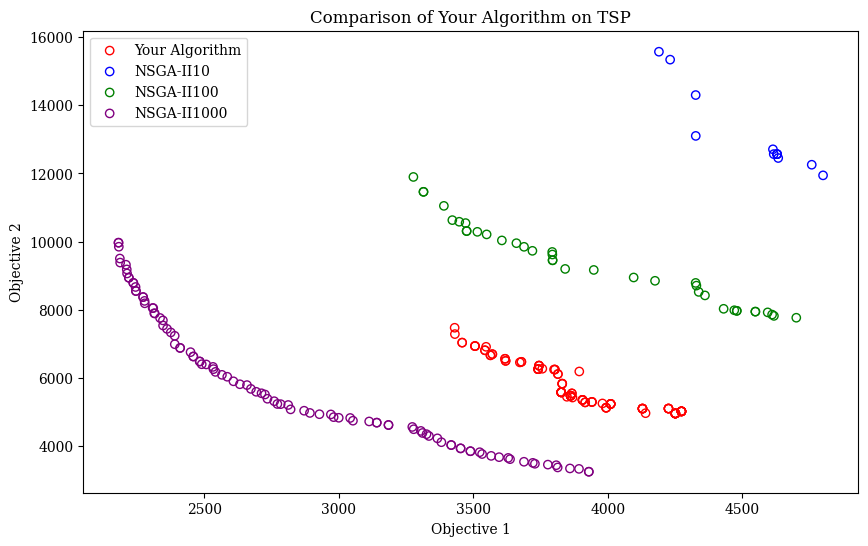

Generation 1/100: Ideal Point = [ 4354.12498752 11882.09339475]
Generation 2/100: Ideal Point = [ 4208.80640086 11533.23977337]
Generation 3/100: Ideal Point = [ 4208.80640086 11363.33800297]
Generation 4/100: Ideal Point = [ 4208.80640086 10831.42514274]
Generation 5/100: Ideal Point = [ 4208.80640086 10117.58865579]
Generation 6/100: Ideal Point = [4183.31263687 9676.61512409]
Generation 7/100: Ideal Point = [4183.31263687 9315.05376432]
Generation 8/100: Ideal Point = [4183.31263687 9208.9636872 ]
Generation 9/100: Ideal Point = [4183.31263687 9171.18989308]
Generation 10/100: Ideal Point = [4183.31263687 9033.97297952]
Generation 11/100: Ideal Point = [4182.61171168 8827.03015137]
Generation 12/100: Ideal Point = [4167.94983368 8686.66946055]
Generation 13/100: Ideal Point = [4077.4732066  8686.66946055]
Generation 14/100: Ideal Point = [4077.4732066  8649.78151195]
Generation 15/100: Ideal Point = [4077.4732066  8635.44007592]
Generation 16/100: Ideal Point = [4077.4732066  8439.1

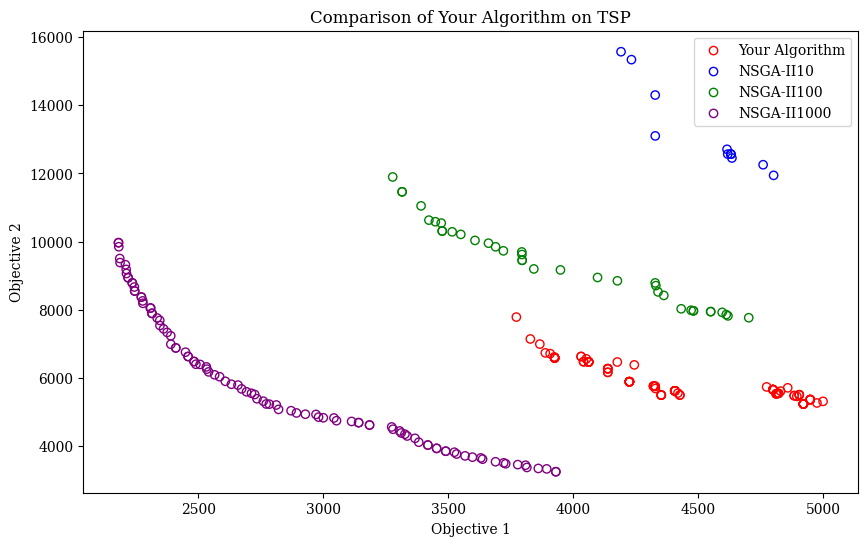

Generation 1/100: Ideal Point = [ 4373.41643747 12225.12193312]
Generation 2/100: Ideal Point = [ 4373.41643747 12169.3708237 ]
Generation 3/100: Ideal Point = [ 4331.84807026 11504.11635645]
Generation 4/100: Ideal Point = [ 4140.06531117 11073.99309529]
Generation 5/100: Ideal Point = [ 4125.20157794 10608.71695009]
Generation 6/100: Ideal Point = [ 3956.5629854  10505.92857848]
Generation 7/100: Ideal Point = [ 3889.57284102 10242.65744307]
Generation 8/100: Ideal Point = [ 3806.26545855 10199.33222824]
Generation 9/100: Ideal Point = [3806.26545855 9852.84853375]
Generation 10/100: Ideal Point = [3784.37454669 9724.16216036]
Generation 11/100: Ideal Point = [3784.37454669 9724.16216036]
Generation 12/100: Ideal Point = [3762.77850183 9601.3202867 ]
Generation 13/100: Ideal Point = [3762.77850183 9548.06750618]
Generation 14/100: Ideal Point = [3686.79385151 9511.51069993]
Generation 15/100: Ideal Point = [3654.2001875  9511.51069993]
Generation 16/100: Ideal Point = [3630.4469807 9

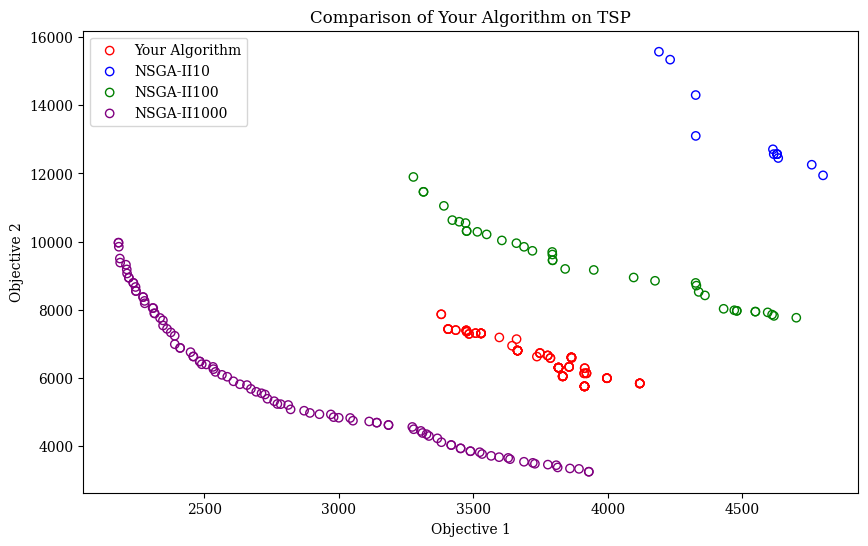

In [ ]:
def initialize_population(pop_size, n_cities):
    """
    Randomly initialize a population of routes (permutations of cities).
    """
    population = [np.random.permutation(n_cities) for _ in range(pop_size)]
    return np.array(population)


def initialize_weights(pop_size, n_objs):
    """
    Generate weight vectors for decomposition.
    """
    weights = np.random.dirichlet(np.ones(n_objs), size=pop_size)
    return weights

# Permutation-based Crossover and Mutation

def crossover(parent1, parent2):
    """
    Order Crossover (OX) for permutations.
    """
    size = len(parent1)
    start, end = sorted(np.random.choice(range(size), 2, replace=False))
    child = -np.ones(size, dtype=int)
    child[start:end+1] = parent1[start:end+1]

    pointer = 0
    for gene in parent2:
        if gene not in child:
            while child[pointer] != -1:
                pointer += 1
            child[pointer] = gene

    return child
# Función para calcular el Hypervolume (HV) y Generational Distance (GD) usando pymoo
def calculate_metrics(solutions, reference_solutions):
    """
    Calcula HV y GD usando las funciones de pymoo.
    """
    reference_point = np.array([np.max(reference_solutions[:, 0]) * 1.1, np.max(reference_solutions[:, 1]) * 1.1])

    # Hypervolume
    hv = HV(ref_point=reference_point)
    hv_value = hv.do(solutions)

    # Generational Distance
    gd = GD(reference_solutions)
    gd_value = gd.do(solutions)

    return hv_value, gd_value


def mutate(route):
    """
    Swap Mutation for permutations.
    """
    i, j = np.random.choice(len(route), 2, replace=False)
    route[i], route[j] = route[j], route[i]
    return route

# Main MOEA/D Algorithm

def moead_tsp(problem, pop_size, max_generations, neighborhood_size):
    """
    MOEA/D for TSP.
    """
    n_cities = problem.n_cities
    n_objs = 2  # Objectives: total_distance and total_time

    # Step 1: Initialization
    population = initialize_population(pop_size, n_cities)
    weights = initialize_weights(pop_size, n_objs)
    neighbors = [np.argsort(np.linalg.norm(weights - w, axis=1))[:neighborhood_size] for w in weights]
    obj_values = np.array([problem.evaluate(ind) for ind in population])
    ideal_point = np.min(obj_values, axis=0)

    # Step 2: Evolutionary Loop
    for generation in range(max_generations):
        for i in range(pop_size):
            # Select two random parents from the neighborhood
            parent_indices = np.random.choice(neighbors[i], 2, replace=False)
            parent1, parent2 = population[parent_indices[0]], population[parent_indices[1]]

            # Crossover and Mutation
            offspring = crossover(parent1, parent2)
            offspring = mutate(offspring)

            # Evaluate objectives
            new_obj_value = problem.evaluate(offspring)

            # Update the ideal point
            ideal_point = np.minimum(ideal_point, new_obj_value)

            # Update the neighborhood
            update_neighbors(population, obj_values, ideal_point, weights, neighbors[i], offspring, new_obj_value)

        # Print progress
        print(f"Generation {generation + 1}/{max_generations}: Ideal Point = {ideal_point}")

    return population, obj_values


def update_neighbors(population, obj_values, ideal_point, weights, neighbors, new_solution, new_obj_value):
    """
    Update the solutions in the neighborhood based on the Tchebycheff approach.
    """
    for i in neighbors:
        # Evaluate the Tchebycheff function for the current and new solutions
        current_tchebycheff = tchebycheff_function(obj_values[i], weights[i], ideal_point)
        new_tchebycheff = tchebycheff_function(new_obj_value, weights[i], ideal_point)

        # Replace the solution if the new one is better
        if new_tchebycheff < current_tchebycheff:
            population[i] = new_solution
            obj_values[i] = new_obj_value


def tchebycheff_function(solution, weights, ideal_point):
    return np.max(weights * np.abs(solution - ideal_point))

# Ejemplo de uso:
n_cities = 100
distances = np.random.uniform(0, 100, size=(n_cities, n_cities))
distances = (distances + distances.T) / 2
times = np.random.uniform(0, 300, size=(n_cities, n_cities))
np.fill_diagonal(distances, 0)
np.fill_diagonal(times, 0)

tsp_problem = TSPProblem(n_cities, distances, times)

# Parámetros
pop_size = 100
max_generations = 100
neighborhood_size = 10

# Run MOEA/D
for i in range(0,5):
    final_population, final_obj_values = moead_tsp(tsp_problem, pop_size, max_generations, neighborhood_size)

    total_populations = []
    total_obj_values = []

    # Results
    print("Final Population:")
    print(final_population)
    print("Final Objective Values:")
    print(final_obj_values)
    total_populations.append(final_population)
    total_obj_values.append(final_obj_values)
    import matplotlib.pyplot as plt
    import numpy as np
    from pymoo.indicators.hv import HV
    from pymoo.indicators.gd import GD
    from pymoo.optimize import minimize



    # Visualizar los resultados
    plt.figure(figsize=(10, 6))

    # Resultado de tu algoritmo
    plt.scatter(final_obj_values[:, 0], final_obj_values[:, 1], label="Your Algorithm", color='r', marker='o', edgecolor='r', facecolor='none')
    plt.scatter(res.F[:, 0], res.F[:, 1], label="NSGA-II10", color='b', marker='o', edgecolor='b', facecolor='none')
    plt.scatter(res2.F[:, 0], res2.F[:, 1], label="NSGA-II100", color='g', marker='o', edgecolor='g', facecolor='none')
    plt.scatter(res3.F[:, 0], res3.F[:, 1], label="NSGA-II1000", color='purple', marker='o', edgecolor='purple', facecolor='none')
    # Resultado de NSGA-II (si se tienen resultados para comparar)
    hv_value_all = []
    gd_value_all = []
    if 'res3' in locals():
        hv_value, gd_value = calculate_metrics(final_obj_values, res3.F)
        hv_value_all.append(hv_value)
        gd_value_all.append(gd_value)
        # Mostrar métricas
        print(f"Hypervolume (HV): {hv_value}")
        print(f"Generational Distance (GD): {gd_value}")
    else:
        print("res3 no está definido. Por favor, ejecuta el algoritmo pymoo para generar el frente de Pareto de referencia.")

    # Etiquetas y leyenda
    plt.xlabel("Objective 1")
    plt.ylabel("Objective 2")
    plt.legend()
    plt.title("Comparison of Your Algorithm on TSP")
    plt.show()


---
### 75.000 gen MOAD

Generation 1/50000: Ideal Point = [ 4490.53949558 12585.75198584]
Generation 2/50000: Ideal Point = [ 4289.7600526  11320.07261293]
Generation 3/50000: Ideal Point = [ 4216.97395333 10967.42288459]
Generation 4/50000: Ideal Point = [ 4045.67138141 10248.63616493]
Generation 5/50000: Ideal Point = [ 3913.81788671 10248.63616493]
Generation 6/50000: Ideal Point = [ 3825.45019494 10248.63616493]
Generation 7/50000: Ideal Point = [3825.45019494 9442.06591144]
Generation 8/50000: Ideal Point = [3740.85907286 9229.12262026]
Generation 9/50000: Ideal Point = [3725.52935278 9229.12262026]
Generation 10/50000: Ideal Point = [3617.18416989 8946.94657196]
Generation 11/50000: Ideal Point = [3617.18416989 8946.94657196]
Generation 12/50000: Ideal Point = [3617.18416989 8831.85633376]
Generation 13/50000: Ideal Point = [3617.18416989 8706.54096221]
Generation 14/50000: Ideal Point = [3617.18416989 8480.19176825]
Generation 15/50000: Ideal Point = [3617.18416989 8480.19176825]
Generation 16/50000: I

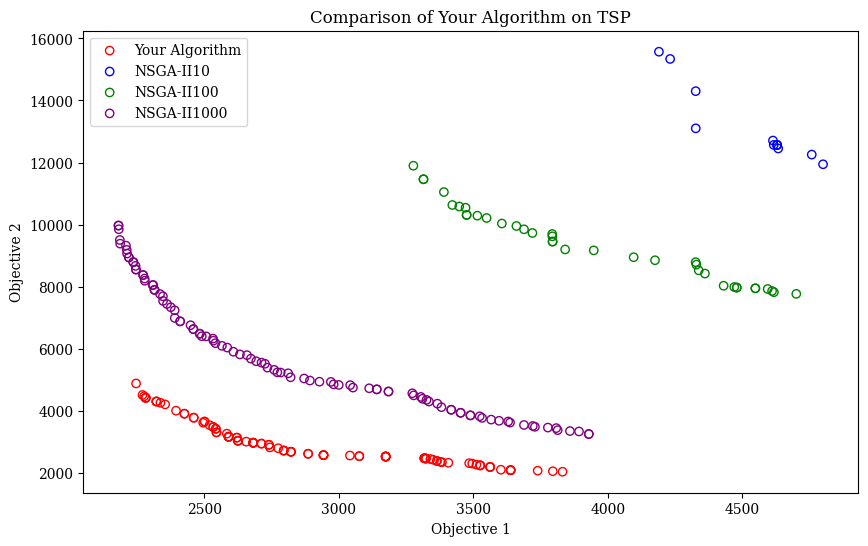

Generation 1/50000: Ideal Point = [ 4335.20248148 11631.25182103]
Generation 2/50000: Ideal Point = [ 4335.20248148 11488.39417222]
Generation 3/50000: Ideal Point = [ 4215.93995509 10762.59742494]
Generation 4/50000: Ideal Point = [ 4128.12290326 10601.33609239]
Generation 5/50000: Ideal Point = [4024.32172633 9818.65449996]
Generation 6/50000: Ideal Point = [4024.32172633 9454.90187109]
Generation 7/50000: Ideal Point = [3946.94717128 9454.90187109]
Generation 8/50000: Ideal Point = [3795.93533577 9454.90187109]
Generation 9/50000: Ideal Point = [3727.74975069 9356.24413899]
Generation 10/50000: Ideal Point = [3639.99659088 9230.54009418]
Generation 11/50000: Ideal Point = [3639.99659088 9168.71318745]
Generation 12/50000: Ideal Point = [3568.97034121 8972.00711277]
Generation 13/50000: Ideal Point = [3568.97034121 8563.10402904]
Generation 14/50000: Ideal Point = [3568.97034121 8057.30461753]
Generation 15/50000: Ideal Point = [3568.97034121 8057.30461753]
Generation 16/50000: Ideal

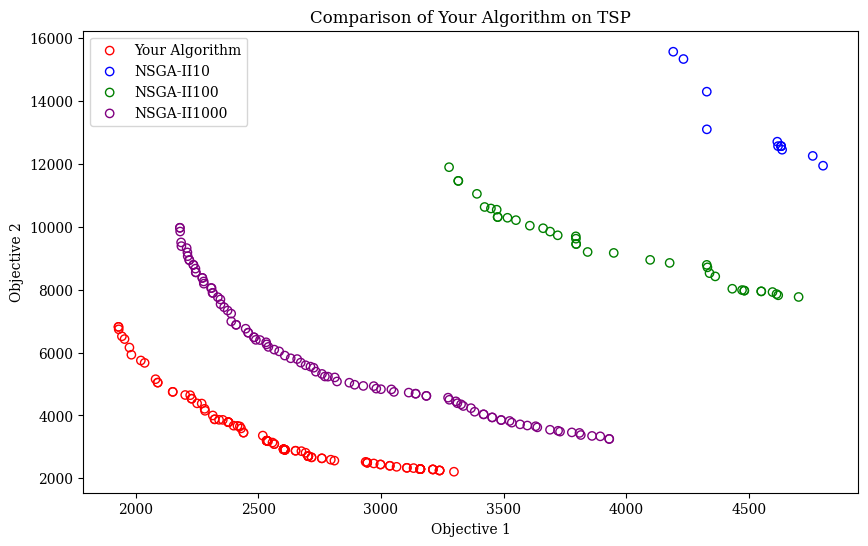

Generation 1/50000: Ideal Point = [ 4248.57027417 12249.15179895]
Generation 2/50000: Ideal Point = [ 4248.57027417 11140.06577537]
Generation 3/50000: Ideal Point = [ 4248.57027417 11077.79323924]
Generation 4/50000: Ideal Point = [ 4191.65826177 10683.05107982]
Generation 5/50000: Ideal Point = [ 4191.65826177 10507.6441888 ]
Generation 6/50000: Ideal Point = [4078.00589379 9475.51275577]
Generation 7/50000: Ideal Point = [4078.00589379 9475.51275577]
Generation 8/50000: Ideal Point = [4078.00589379 9253.7075319 ]
Generation 9/50000: Ideal Point = [4078.00589379 8906.88661753]
Generation 10/50000: Ideal Point = [4078.00589379 8767.67292208]
Generation 11/50000: Ideal Point = [4042.79849058 8702.62279921]
Generation 12/50000: Ideal Point = [4042.79849058 8702.62279921]
Generation 13/50000: Ideal Point = [4042.79849058 8435.80795173]
Generation 14/50000: Ideal Point = [4020.67979718 8435.80795173]
Generation 15/50000: Ideal Point = [4020.67979718 8178.53691596]
Generation 16/50000: Ide

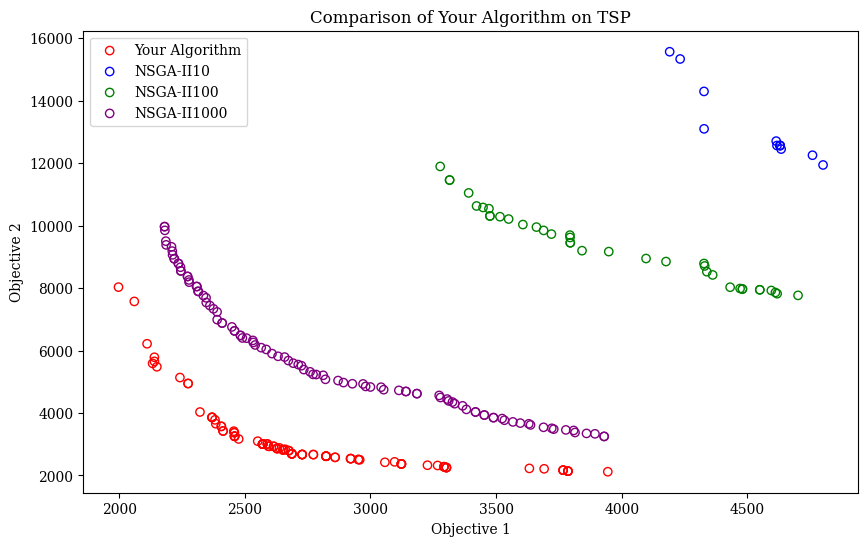

Generation 1/50000: Ideal Point = [ 4408.57705196 12319.06873967]
Generation 2/50000: Ideal Point = [ 4408.57705196 11603.25929937]
Generation 3/50000: Ideal Point = [ 4302.15758582 10593.85585512]
Generation 4/50000: Ideal Point = [ 4302.15758582 10439.11853854]
Generation 5/50000: Ideal Point = [ 4287.78704224 10280.36109798]
Generation 6/50000: Ideal Point = [4287.78704224 9919.13412125]
Generation 7/50000: Ideal Point = [4259.79049981 9596.36079288]
Generation 8/50000: Ideal Point = [4259.79049981 9538.84530473]
Generation 9/50000: Ideal Point = [4259.79049981 9377.84680904]
Generation 10/50000: Ideal Point = [4186.24608158 8988.63842454]
Generation 11/50000: Ideal Point = [4186.24608158 8663.89237953]
Generation 12/50000: Ideal Point = [4186.24608158 8581.91190742]
Generation 13/50000: Ideal Point = [4186.24608158 8536.13062116]
Generation 14/50000: Ideal Point = [4186.24608158 8536.13062116]
Generation 15/50000: Ideal Point = [4089.26089301 8536.13062116]
Generation 16/50000: Ide

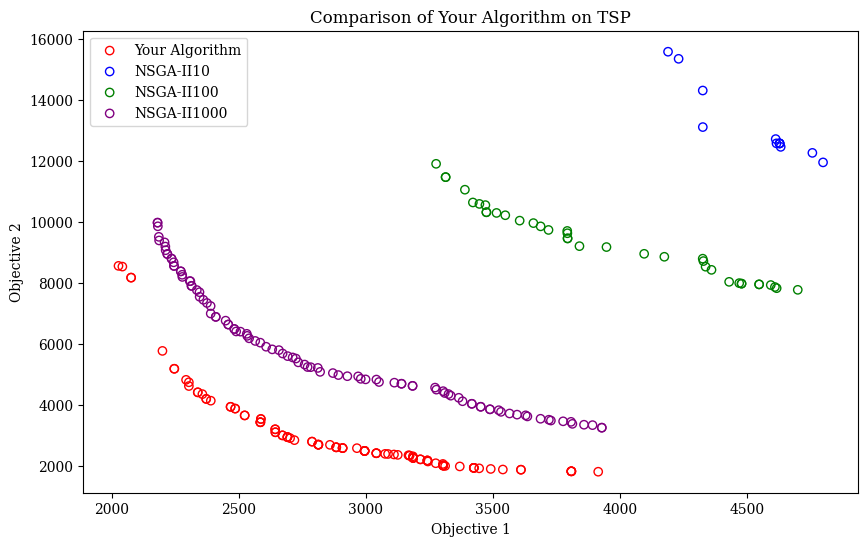

In [ ]:
n_cities = 100
distances = np.random.uniform(0, 100, size=(n_cities, n_cities))
distances = (distances + distances.T) / 2
times = np.random.uniform(0, 300, size=(n_cities, n_cities))
np.fill_diagonal(distances, 0)
np.fill_diagonal(times, 0)

tsp_problem = TSPProblem(n_cities, distances, times)

# Parámetros
pop_size = 100
max_generations = 50_000
neighborhood_size = 10

# Run MOEA/D
for i in range(0,4):
    final_population, final_obj_values = moead_tsp(tsp_problem, pop_size, max_generations, neighborhood_size)

    total_populations = []
    total_obj_values = []

    # Results
    print("Final Population:")
    print(final_population)
    print("Final Objective Values:")
    print(final_obj_values)
    total_populations.append(final_population)
    total_obj_values.append(final_obj_values)
    import matplotlib.pyplot as plt
    import numpy as np
    from pymoo.indicators.hv import HV
    from pymoo.indicators.gd import GD
    from pymoo.optimize import minimize



    # Visualizar los resultados
    plt.figure(figsize=(10, 6))

    # Resultado de tu algoritmo
    plt.scatter(final_obj_values[:, 0], final_obj_values[:, 1], label="Your Algorithm", color='r', marker='o', edgecolor='r', facecolor='none')
    plt.scatter(res.F[:, 0], res.F[:, 1], label="NSGA-II10", color='b', marker='o', edgecolor='b', facecolor='none')
    plt.scatter(res2.F[:, 0], res2.F[:, 1], label="NSGA-II100", color='g', marker='o', edgecolor='g', facecolor='none')
    plt.scatter(res3.F[:, 0], res3.F[:, 1], label="NSGA-II1000", color='purple', marker='o', edgecolor='purple', facecolor='none')
    hv_value_all = []
    gd_value_all = []
    if 'res3' in locals():
        hv_value, gd_value = calculate_metrics(final_obj_values, res3.F)
        hv_value_all.append(hv_value)
        gd_value_all.append(gd_value)
        # Mostrar métricas
        print(f"Hypervolume (HV): {hv_value}")
        print(f"Generational Distance (GD): {gd_value}")
    else:
        print("res3 no está definido. Por favor, ejecuta el algoritmo pymoo para generar el frente de Pareto de referencia.")

    # Etiquetas y leyenda
    plt.xlabel("Objective 1")
    plt.ylabel("Objective 2")
    plt.legend()
    plt.title("Comparison of Your Algorithm on TSP")
    plt.show()
